Homework 3:
---

For this assignment, I modified [Ugur Uysal's code](https://github.com/UgurUysal86/MLS4MIL/tree/master/Image%20Classification) to work properly without the Civilian Cars data. The training accuracy is not as high as I would hope but the time taken to train this model did not allow for much tinkering without waiting forever to see results.

My senior design project ended up taking a lot more of my time than I thought near the end so I did not get to take as much time as I wanted to on this assignment.

---


## GPU Assigned on Colab
This method was taken from the discussions post by M____ on the class Webcourses. It prints out the assigned GPU for a colab notebook and helped me locate a good GPU (Tesla P100) with 16 GB of memory.

It was very exciting to see that in the first couple of tries I got this GPU because it allowed me to increase the batch size without getting errors of running out of memory.

In [0]:
def print_assigned_gpu():
  from tensorflow.python.client import device_lib
  for x in device_lib.list_local_devices():
    if x.device_type == "GPU":
      print("***** GPU Information *****")
      print("Device Name: " , x.name)
      print("Memory Limit: " , "%.2f" % float(x.memory_limit/(1000*1000*1000)), "GB")
      print("Description: " , x.physical_device_desc)
      return "compute capability: 6.0" in x.physical_device_desc
print(print_assigned_gpu())

***** GPU Information *****
Device Name:  /device:GPU:0
Memory Limit:  15.96 GB
Description:  device: 0, name: Tesla P100-PCIE-16GB, pci bus id: 0000:00:04.0, compute capability: 6.0
True


## Mount Google Drive to /content/drive and extract RuTanks7000_v1.NoCivCars.zip
---

I extracted The RuTanks7000_v1.zip and removed the Civilian Cars data from the dataset. After this, I uploaded it to my Google Drive and imported it to this notebook.

Importing a zip from Google Drive was honestly much simpler than I thought. Google Drive allows for extremely large files and being able to import them so seemlessly to this cloud notebook was very surprising.

After importing, the zip is copied to the local machine and extracted



In [0]:
from google.colab import drive

drive.mount('/content/drive')
!cp /content/drive/My\ Drive/RuTanks7000_v1.NoCivCars.zip /content/RuTanks7000_v1.NoCivCars.zip && ls

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
 drive			        sample_data
'logs\level1'		       'trained_models\RuTanks7000_v1_l1.h5'
 RuTanks7000_v1		       'trained_models\trained_weights\weights_temp.h5'
 RuTanks7000_v1.NoCivCars.zip


In [0]:
!rm -rf RuTanks7000_v1/ && unzip -q RuTanks7000_v1.NoCivCars.zip && ls

 drive			        sample_data
'logs\level1'		       'trained_models\RuTanks7000_v1_l1.h5'
 RuTanks7000_v1		       'trained_models\trained_weights\weights_temp.h5'
 RuTanks7000_v1.NoCivCars.zip


# Model Training and Weight Saving
---

This section trains the entire model. Both Level 1 and Level 2 of [Ugur's training code](https://github.com/UgurUysal86/MLS4MIL/blob/master/Image%20Classification/code/RuTanks_train.py) are executed here so the first set of training occurs and then the fine tuning.

Level 2 trains after unfreezing the base model

This is the bulk of the run time and training results are seen below:


## Import libraries

In [0]:
# imports
import os
from keras.applications import NASNetLarge
from keras import models, layers, optimizers, backend
from keras.models import load_model
from keras.preprocessing.image import ImageDataGenerator
from keras.callbacks import ModelCheckpoint, ReduceLROnPlateau, TensorBoard
import matplotlib.pyplot as plt
import numpy as np
from timeit import default_timer as timer


## Helper methods

In [0]:
# function to plot results of model performance
def plot(h,t,e):
    history_dict = h[0]
    loss_values = history_dict['loss']
    validation_loss_values = history_dict['val_loss']
    acc_values = history_dict['acc']
    validation_acc_values = history_dict['val_acc']
    epochs_range = range(1, e + 1)

    # Plotting Training and Validation loss of the corresponding Model
    plt.plot(epochs_range, loss_values, 'bo', label='Training loss')
    plt.plot(epochs_range, validation_loss_values, 'ro', label='Validation loss')
    plt.title('Training and validation loss of ' + t)
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.yticks(np.arange(0, 3.1, step=0.2))
    plt.legend()
    plt.show()

    # Plotting Training and Validation accuracy of the corresponding Model
    plt.plot(epochs_range, acc_values, 'bo', label='Training accuracy')
    plt.plot(epochs_range, validation_acc_values, 'ro', label='Validation accuracy')
    plt.title('Training and validation accuracy of ' + t)
    plt.xlabel('Epochs')
    plt.ylabel('Accuracy')
    plt.yticks(np.arange(0.3, 1.1, step=0.1))
    plt.legend()
    plt.show()

## Declare initial parameters

In [0]:
# image settings
img_height,img_width = 331, 331  # For NASNetLarge

# classes
classnames = ["Background", "BMP2", "Buk-M1-2", "T14", "T90", "ZSU23"]
classes = len(classnames)

# path settings
path = '/content/'
dataset_path = path + 'RuTanks7000_v1/'
weights_path = path+'trained_models\\trained_weights\\weights_temp.h5'
model_path = path+'trained_models\\RuTanks7000_v1_'
TensorBoardLogDir = path+'logs'

## Initialize Model Parameters

In [0]:
# unfreezing the base network up to a specific layer in Level2:
freezeUptoLayer = "normal_add_1_15"   # NASNetLarge

# hyperparameters
learning_rate = 0.0002  # Learning_rate in Level 2 = learning_rate/10
lr_decay = 0.0001
batch = 64
fcLayer1 = 32
dropout = 0.5

epochsL1 = 10
patiencel1 = 1
factorL1 = 0.5

epochsL2 = 10
patiencel2 = 1
factorL2 = 0.5

verbose_train = 1

## Process images

In [0]:
nbrTrainImages = 7000  # per class
nbrTestImages = 0  # Value gets accurate after counting (Total Number of test images)
for ImagesClass in os.listdir(dataset_path+'test/'):
    print (ImagesClass)
    nbrTestImages += len(os.listdir(dataset_path+'test/'+ImagesClass))
  
# datagenerators https://keras.io/preprocessing/image/
train_datagen = ImageDataGenerator(
    rescale=1./255,
    rotation_range=30,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    fill_mode='nearest',
    horizontal_flip=True)
train_generator = train_datagen.flow_from_directory(
    dataset_path+'train',
    target_size=(img_height, img_width),
    batch_size=batch,
    shuffle=True,
    classes=classnames,
    class_mode='categorical')

test_datagen = ImageDataGenerator(rescale=1./255)
test_generator = test_datagen.flow_from_directory(
    dataset_path+'test',
    target_size=(img_height, img_width),
    batch_size=1,
    shuffle=True,
    classes=classnames,
    class_mode='categorical')

ZSU23
Buk-M1-2
BMP2
Background
T90
T14
Found 42000 images belonging to 6 classes.
Found 90 images belonging to 6 classes.


## Level 1 and Level 2

In [0]:
# LEVEL1 - Training of densely connected layers
def level1():
    # Building the model using the pretrained model
    conv_base1 = NASNetLarge(weights='imagenet', include_top=False, input_shape=(img_height, img_width, 3))
    print("\n### LEVEL1 ###\npretrained network:")
    conv_base1.summary()
    model = models.Sequential()
    model.add(conv_base1)
    model.add(layers.GlobalAveragePooling2D())
    model.add(layers.Dense(fcLayer1, activation='relu'))
    model.add(layers.Dropout(dropout))
    model.add(layers.Dense(classes, activation='softmax'))

    # freezing the base network
    print("trainable layers bevor freezing:", int(len(model.trainable_weights)/2)) # weights = weights + bias = 2 pro layer
    conv_base1.trainable = False
    print("trainable layers after freezing:", int(len(model.trainable_weights)/2))
    print("\npretrained network + densely connected classifier")
    model.summary()

    # training the added layers only
    model.compile(loss='categorical_crossentropy', optimizer=optimizers.RMSprop(lr=learning_rate, decay=lr_decay), metrics=['acc'])

    callbacks_list_L1 = [ModelCheckpoint(filepath=weights_path, save_weights_only=True, monitor='val_acc', verbose=1, save_best_only=True),
                      ReduceLROnPlateau(monitor='val_acc', factor=factorL1, patience=patiencel1, verbose=1),
                      TensorBoard(log_dir=TensorBoardLogDir+'\\level1')]

    print("\n### Level1 Training ... ")
    # training the model
    history = model.fit_generator(
        train_generator,
        steps_per_epoch=(nbrTrainImages * classes) // (batch * 5),
        epochs=epochsL1,
        callbacks=callbacks_list_L1,
        validation_data=test_generator,
        validation_steps=nbrTestImages,
        verbose=verbose_train)

    history_val1 = [history.history]  # saving all results of the final test
    plot(history_val1, "LEVEL1:", epochsL1)
    print("\n### LEVEL1 Training finished successfully ###")

    print("\nLoading trained weights from " + weights_path + " ...")
    model.load_weights(weights_path)
    model.compile(loss='categorical_crossentropy', optimizer=optimizers.RMSprop(lr=learning_rate), metrics=['acc'])
    print("\n### Saving Level1 Model to ", model_path+'l1.h5', " ... ")
    model.save(model_path+'l1.h5')

In [0]:
# LEVEL2 - Training pretrained network and trained densely connected layers
def level2():
    # Destroying the current TF graph - https://keras.io/backend/
    backend.clear_session()
    print("\n### LEVEL2 ###")
    conv_base2 = NASNetLarge(weights='imagenet', include_top=False, input_shape=(img_height, img_width, 3))
    model2 = models.Sequential()
    model2.add(conv_base2)
    model2.add(layers.GlobalAveragePooling2D())
    model2.add(layers.Dense(fcLayer1, activation='relu'))
    model2.add(layers.Dropout(dropout))
    model2.add(layers.Dense(classes, activation='softmax'))

    print("\nLoading trained weights from " + weights_path + " ...")
    model2.load_weights(weights_path)

    # unfreezing the base network up to a specific layer:
    if freezeUptoLayer == "":
        conv_base2.trainable = True
        print ("\ntrainable layers: ",int(len(model2.trainable_weights) / 2))
    else:
        print("\ntrainable layers before unfreezing the base network up to " + freezeUptoLayer + ": ",int(len(model2.trainable_weights) / 2))  # weights = weights + bias = 2 pro layer
        conv_base2.trainable = True
        set_trainable = False
        for layer in conv_base2.layers:
            if layer.name == freezeUptoLayer: set_trainable = True
            if set_trainable: layer.trainable = True
            else: layer.trainable = False
        print("trainable layers after the base network unfreezed from layer " + freezeUptoLayer + ": ", int(len(model2.trainable_weights)/2))

    print("\nLEVEL2 Model after unfreezing the base network")
    model2.summary()
    model2.compile(loss='categorical_crossentropy', optimizer=optimizers.RMSprop(lr=learning_rate/10, decay=lr_decay), metrics=['acc'])
    print ("\n### Validating ... ")

    val_loss, val_acc = model2.evaluate_generator(test_generator, steps=nbrTestImages, verbose=0)
    print('Validation Results before training unfreeze layers and trained densely connected layers:\nValidation loss:',val_loss,",",'Validation accuracy:', val_acc, "\n")

    # Jointly training both the unfreeze layers and the added trained densely connected layers
    callbacks_list_L2 = [ModelCheckpoint(filepath=model_path+'l2.h5', save_weights_only=False, monitor='val_acc', verbose=1, save_best_only=True),
                      ReduceLROnPlateau(monitor='val_acc', factor=factorL2, patience=patiencel2, verbose=1),
                      TensorBoard(log_dir=TensorBoardLogDir+'\\level2')]

    print ("\n### Level2 Training ... ")
    history = model2.fit_generator(
        train_generator,
        steps_per_epoch=(nbrTrainImages * classes) // (batch * 5),
        epochs=epochsL2,
        callbacks=callbacks_list_L2,
        validation_data=test_generator,
        validation_steps=nbrTestImages,
        verbose=verbose_train)

    history_val2 = [history.history]  # saving all results of the final test
    plot(history_val2, "LEVEL2:", epochsL2)
    print("\n###LEVEL2 Training finished successfully ###")

# References
# Chollet, F. (2018). Deep learning with Python. Section 5.3 - Using a pretrained convnet.


# Run the ML Train


### LEVEL1 ###
pretrained network:
Model: "NASNet"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_2 (InputLayer)            (None, 331, 331, 3)  0                                            
__________________________________________________________________________________________________
stem_conv1 (Conv2D)             (None, 165, 165, 96) 2592        input_2[0][0]                    
__________________________________________________________________________________________________
stem_bn1 (BatchNormalization)   (None, 165, 165, 96) 384         stem_conv1[0][0]                 
__________________________________________________________________________________________________
activation_261 (Activation)     (None, 165, 165, 96) 0           stem_bn1[0][0]                   
_________________________________________________________

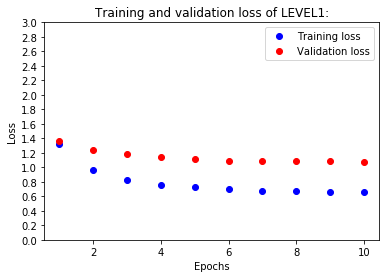

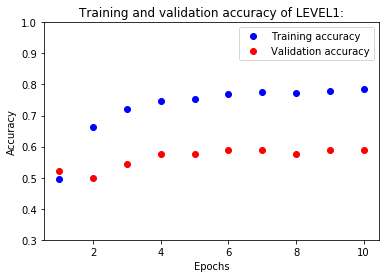


### LEVEL1 Training finished successfully ###

Loading trained weights from /content/trained_models\trained_weights\weights_temp.h5 ...

### Saving Level1 Model to  /content/trained_models\RuTanks7000_v1_l1.h5  ... 

### LEVEL2 ###

Loading trained weights from /content/trained_models\trained_weights\weights_temp.h5 ...

trainable layers before unfreezing the base network up to normal_add_1_15:  510
trainable layers after the base network unfreezed from layer normal_add_1_15:  71

LEVEL2 Model after unfreezing the base network
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
NASNet (Model)               (None, 11, 11, 4032)      84916818  
_________________________________________________________________
global_average_pooling2d_1 ( (None, 4032)              0         
_________________________________________________________________
dense_1 (Dense)              (None, 32)         

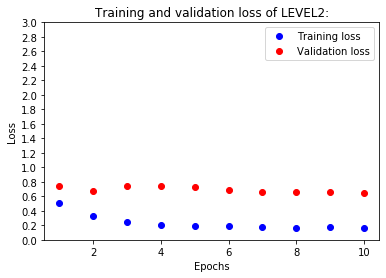

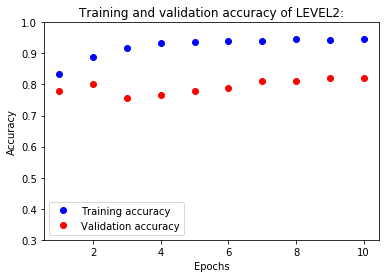


###LEVEL2 Training finished successfully ###
Time elapsed in minutes:  86.16934153118335


In [36]:
start = timer()
level1()
level2()
end = timer()
print("Time elapsed in minutes: ", ((end - start)/60))

# Analysis Code

This section is [Ugur's Analysis code](https://github.com/UgurUysal86/MLS4MIL/blob/master/Image%20Classification/code/RuTanks_analyze.py) loads the saved model from the training from the previous section.

The results for this can be seen below:

## Import Statements

In [0]:
# Ugur Uysal
# ugur.uysal.86@gmail.com
# 02. Aug 2019

import os
import matplotlib.pyplot as plt
import numpy as np
from keras import models
from keras.preprocessing import image
from sklearn.metrics import classification_report, confusion_matrix
from sklearn.manifold import TSNE
import seaborn as sns

## Helper Methods

In [0]:
def analysis():
    # testing the model
    print("\n### Testing the loaded model ... ")
    test_loss, test_acc = model.evaluate_generator(test_generator, steps=nbrTestImages, verbose=1)
    print('Test Results of the trained Model:\nTest loss:', test_loss, ",", 'test accuracy:', test_acc)

    # Confusion Matrix and Classification Report
    pred_argmax = np.argmax(pred, axis=1)
    print('\nConfusion Matrix')
    print(confusion_matrix(test_generator.classes, pred_argmax))
    print('\nClassification Report')
    print(classification_report(test_generator.classes, pred_argmax, target_names=classnames))

    # t-SNE Visualization: t-Distributed Stochastic Neighbor Embedding (t-SNE) for visualizing high-dimensional data.
    img_tensors = []
    for i in range(len(test_images)):
        pred_img = image.load_img(test_images_path[i], target_size=(331, 331))
        img_tensor = image.img_to_array(pred_img)
        img_tensor = np.expand_dims(img_tensor, axis=0)
        img_tensor /= 255.
        img_tensors.append(img_tensor)

    # Last conv layer
    layer = model.get_layer('dense_1')
    layer_output = layer.output
    activation_model = models.Model(input=model.input, outputs=[layer_output])

    img_tensors = np.asarray(img_tensors)
    img_tensors_array = np.concatenate((img_tensors))
    print("img_tensors_array.shape=", img_tensors_array.shape)

    activations = activation_model.predict(img_tensors_array)
    print("activations.shape=", activations.shape)

    # calculating tsne #https://www.datacamp.com/community/tutorials/introduction-t-sne
    tsne = TSNE(random_state=42).fit_transform(activations)

    # Visualization of the feature vectors produce by the convnet
    num_classes = len(classnames)
    palette = np.array(sns.color_palette("husl", num_classes))
    label_array = np.asarray(true_labels)

    # create a scatter plot.
    fig = plt.figure(figsize=(12, 12))
    fig.patch.set_facecolor('black')
    plt.style.use('dark_background')
    plt.scatter(tsne[:, 0], tsne[:, 1], lw=0, s=90, c=palette[label_array])
    plt.axis('tight')

    txts = []
    for j in range(num_classes):
        # Position of each label at median of data points.
        xtext, ytext = np.median(tsne[label_array == j, :], axis=0)
        txt = plt.text(xtext, ytext, classnames[j], fontsize=28, color = 'w')
        txts.append(txt)
    plt.show()


def plot_images():
    # plotting test images with class predictions as title
    print("\nClass Predictions of test images from", test_path)
    for k in range(len(test_images)):
        predictions = []
        for l in range(len(classnames)):
            predictions.append((np.round(pred[k][l] * 100, 2), classnames[l]))
        predictions.sort(reverse=True)
        print("Image", k + 1, ":", predictions)

        plt.figure(figsize=(8, 8))  # width, height in inches.
        plt.style.use('dark_background')
        plt.suptitle("Class prediction of a " + true_labels_class[k] + " image" + "\n(Test image " + str(k + 1) + ")", fontsize=18)
        plt.grid(False)
        plt.xticks([])
        plt.yticks([])
        legend_string = "Prediction: " + \
                        "\n%.2f" % predictions[0][0] + "% " + predictions[0][1] + \
                        "\n%.2f" % predictions[1][0] + "% " + predictions[1][1] + \
                        "\n%.2f" % predictions[2][0] + "% " + predictions[2][1] + \
                        "\n%.2f" % predictions[3][0] + "% " + predictions[3][1] + \
                        "\n%.2f" % predictions[4][0] + "% " + predictions[4][1] + \
                        "\n%.2f" % predictions[5][0] + "% " + predictions[5][1]
        plt.text(img_width + 10, 125, legend_string, fontsize=16)
        plt.imshow(test_images[k])
        plt.show()

## Declare Initial Parameters

In [0]:
# Setting Parameters ##################################################################
path = '/content/'
dataset_path = path + 'RuTanks7000_v1/'
model_path = path+'trained_models/'

model_path = model_path + 'RuTanks7000_v1_l2.h5'
test_path = dataset_path + 'test/'

# image settings
img_height, img_width = 331, 331

classnames = ["Background", "BMP2", "Buk-M1-2", "T14", "T90", "ZSU23"]

##  Image Preparation

In [45]:
# test data generator
test_datagen = image.ImageDataGenerator(rescale=1. / 255)
test_generator = test_datagen.flow_from_directory(
    test_path,
    target_size=(img_height, img_width),
    batch_size=1,
    shuffle=False,
    classes=classnames,
    class_mode='categorical')

# counting test images
nbrTestImages = 0  # Value gets accurate after counting
for ImagesClass in os.listdir(test_path):
    nbrTestImages += len(os.listdir(test_path + ImagesClass))

# saving test images from test generator
test_images = []
for i in range(nbrTestImages):
    test_images.append(test_generator.next()[0][0])

test_images_path = []
true_labels = []
true_labels_class = []

test_images_Background = os.listdir(test_path + 'Background')
for imagefile in test_images_Background:
    test_images_path.append(test_path + 'Background/' + imagefile)
    true_labels.append(0)
    true_labels_class.append('Background')

test_images_BMP2 = os.listdir(test_path + 'BMP2')
for imagefile in test_images_BMP2:
    test_images_path.append(test_path + 'BMP2/' + imagefile)
    true_labels.append(1)
    true_labels_class.append('BMP2')

test_images_Buk = os.listdir(test_path + 'Buk-M1-2')
for imagefile in test_images_Buk:
    test_images_path.append(test_path + 'Buk-M1-2/' + imagefile)
    true_labels.append(2)
    true_labels_class.append('Buk-M1-2')

test_images_T14 = os.listdir(test_path + 'T14')
for imagefile in test_images_T14:
    test_images_path.append(test_path + 'T14/' + imagefile)
    true_labels.append(3)
    true_labels_class.append('T14')

test_images_T90 = os.listdir(test_path + 'T90')
for imagefile in test_images_T90:
    test_images_path.append(test_path + 'T90/' + imagefile)
    true_labels.append(4)
    true_labels_class.append('T90')

test_images_ZSU23 = os.listdir(test_path + 'ZSU23')
for imagefile in test_images_ZSU23:
    test_images_path.append(test_path + 'ZSU23/' + imagefile)
    true_labels.append(5)
    true_labels_class.append('ZSU23')

Found 90 images belonging to 6 classes.


## Load the model and predict from test data

In [56]:
!mkdir trained_models && mkdir logs
!cd trained_models && mkdir trained_weights

mkdir: cannot create directory ‘trained_weights’: File exists


In [57]:
!ls
!mv 'trained_models\RuTanks7000_v1_l2.h5' RuTanks7000_v1_l2.h5
!mv 'trained_models\RuTanks7000_v1_l1.h5' RuTanks7000_v1_l1.h5
!mv 'trained_models\trained_weights\weights_temp.h5' weights_temp.h5
!mv 'logs\level1' logs/level1
!mv 'logs\level2' logs/level2

!mv RuTanks7000_v1_l1.h5 trained_models/RuTanks7000_v1_l1.h5
!mv RuTanks7000_v1_l2.h5 trained_models/RuTanks7000_v1_l2.h5
!mv weights_temp.h5 trained_models/trained_weights/weights_temp.h5

 drive		        RuTanks7000_v1.NoCivCars.zip
 logs		        sample_data
'logs\level1'	        trained_models
'logs\level2'	       'trained_models\RuTanks7000_v1_l1.h5'
 RuTanks7000_v1        'trained_models\trained_weights\weights_temp.h5'
 RuTanks7000_v1_l2.h5
mv: cannot stat 'trained_models\RuTanks7000_v1_l2.h5': No such file or directory


In [58]:
!ls

drive  RuTanks7000_v1		     sample_data
logs   RuTanks7000_v1.NoCivCars.zip  trained_models


In [59]:
# Returns the compiled model identical to the previously saved one
print("Loading the trained model from " + model_path + " ...\n")
model = models.load_model(model_path)
print("\nTrained model " + model_path + ":")
model.summary()

# predicting labels
pred = model.predict_generator(test_generator, nbrTestImages)
print("Dataset at", test_path, "has", pred.shape[0], "images with", pred.shape[1], "class predictions each")

Loading the trained model from /content/trained_models/RuTanks7000_v1_l2.h5 ...


Trained model /content/trained_models/RuTanks7000_v1_l2.h5:
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
NASNet (Model)               (None, 11, 11, 4032)      84916818  
_________________________________________________________________
global_average_pooling2d_1 ( (None, 4032)              0         
_________________________________________________________________
dense_1 (Dense)              (None, 32)                129056    
_________________________________________________________________
dropout_1 (Dropout)          (None, 32)                0         
_________________________________________________________________
dense_2 (Dense)              (None, 6)                 198       
Total params: 85,046,072
Trainable params: 30,292,646
Non-trainable params: 54,753,426
_______________________

# Run the Analysis

All-in-all, this method of training a network is immensely powerful. 

Accuracy is sitting at a very high 95% for testing but sits at a comfortable 82% for validation.

The model is definitely overfitting the training examples but given how it was trained on completely generated data from photorealistic examples of military vehicles and tested on their real-life counterparts, it is extremely impressive.

The use of game engines for generating data can be a game-changer (no pun intended) for the Defense industry since it is often not feasible to have the images of the objects in different environments.


### Testing the loaded model ... 
90/90 [==============================] - 20s 221ms/step
Test Results of the trained Model:
Test loss: 0.6535320290120177 , test accuracy: 0.8222222222222222

Confusion Matrix
[[15  0  0  0  0  0]
 [ 1 12  1  1  0  0]
 [ 0  0 15  0  0  0]
 [ 0  4  2  7  0  2]
 [ 0  0  0  1 14  0]
 [ 0  1  3  0  0 11]]

Classification Report
              precision    recall  f1-score   support

  Background       0.94      1.00      0.97        15
        BMP2       0.71      0.80      0.75        15
    Buk-M1-2       0.71      1.00      0.83        15
         T14       0.78      0.47      0.58        15
         T90       1.00      0.93      0.97        15
       ZSU23       0.85      0.73      0.79        15

    accuracy                           0.82        90
   macro avg       0.83      0.82      0.81        90
weighted avg       0.83      0.82      0.81        90



/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:26: UserWarning: Update your `Model` call to the Keras 2 API: `Model(outputs=[<tf.Tenso..., inputs=Tensor("NA...)`


img_tensors_array.shape= (90, 331, 331, 3)
activations.shape= (90, 32)


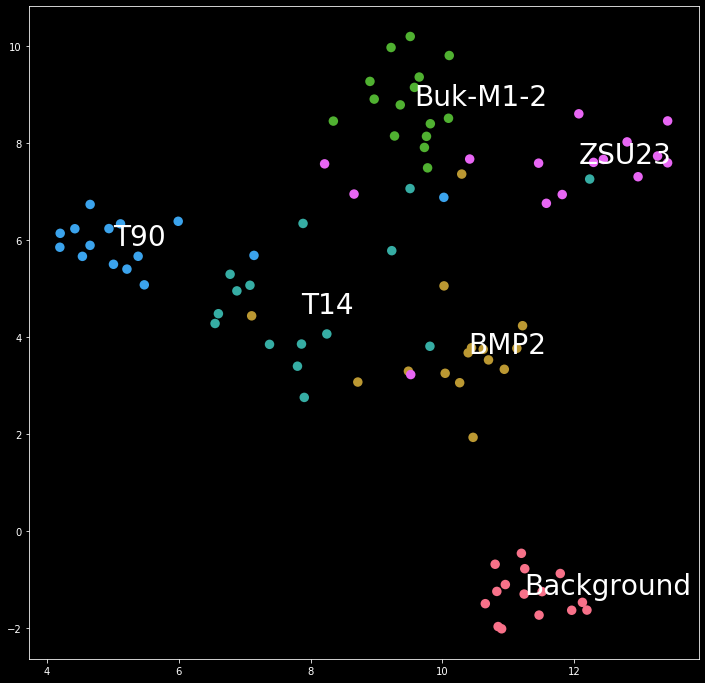


Class Predictions of test images from /content/RuTanks7000_v1/test/
Image 1 : [(99.95, 'Background'), (0.04, 'T90'), (0.0, 'ZSU23'), (0.0, 'T14'), (0.0, 'Buk-M1-2'), (0.0, 'BMP2')]


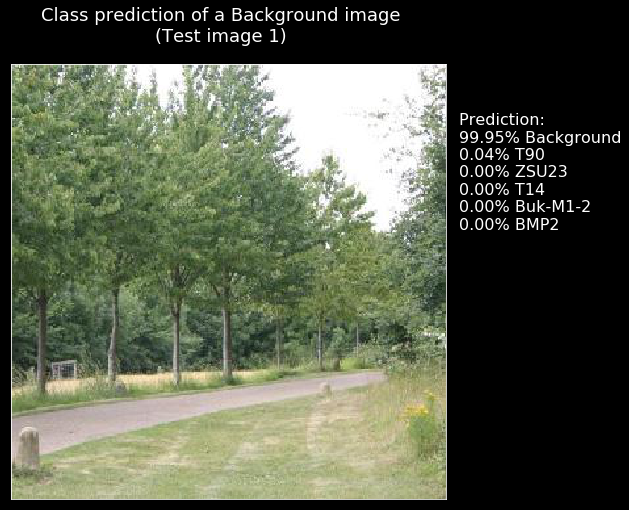

Image 2 : [(99.85, 'Background'), (0.06, 'BMP2'), (0.04, 'T90'), (0.03, 'Buk-M1-2'), (0.02, 'T14'), (0.01, 'ZSU23')]


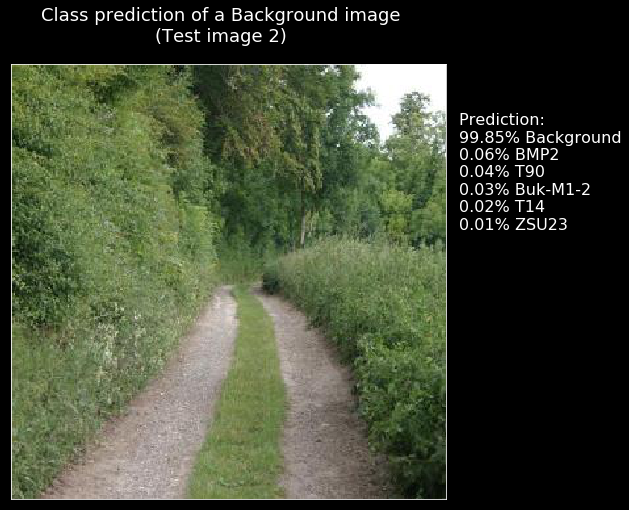

Image 3 : [(99.86, 'Background'), (0.05, 'T90'), (0.04, 'Buk-M1-2'), (0.04, 'BMP2'), (0.01, 'ZSU23'), (0.01, 'T14')]


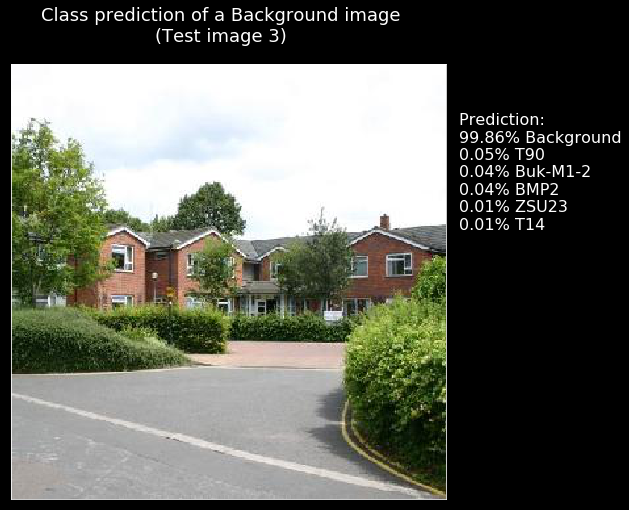

Image 4 : [(99.74, 'Background'), (0.24, 'T90'), (0.01, 'ZSU23'), (0.01, 'T14'), (0.0, 'Buk-M1-2'), (0.0, 'BMP2')]


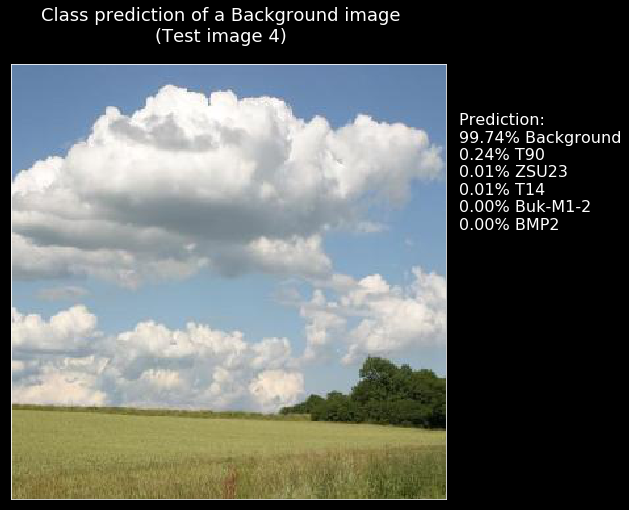

Image 5 : [(99.12, 'Background'), (0.29, 'BMP2'), (0.28, 'Buk-M1-2'), (0.25, 'T90'), (0.03, 'ZSU23'), (0.03, 'T14')]


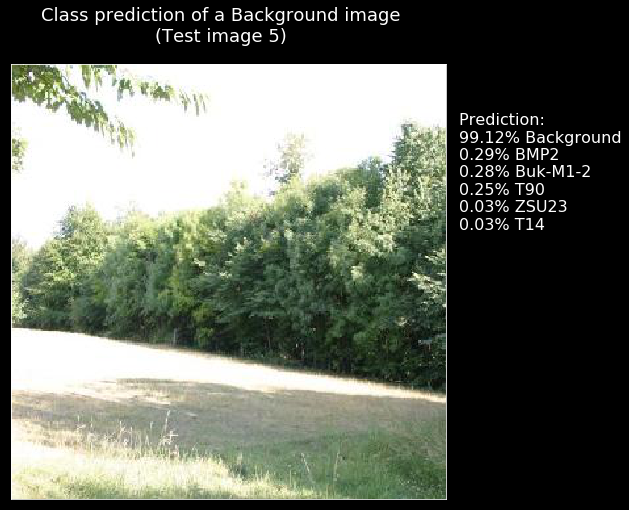

Image 6 : [(99.97, 'Background'), (0.02, 'BMP2'), (0.01, 'T90'), (0.0, 'ZSU23'), (0.0, 'T14'), (0.0, 'Buk-M1-2')]


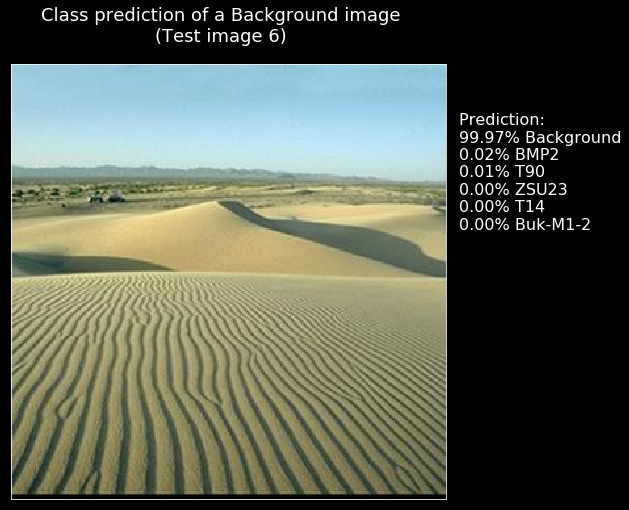

Image 7 : [(99.97, 'Background'), (0.02, 'T90'), (0.01, 'BMP2'), (0.0, 'ZSU23'), (0.0, 'T14'), (0.0, 'Buk-M1-2')]


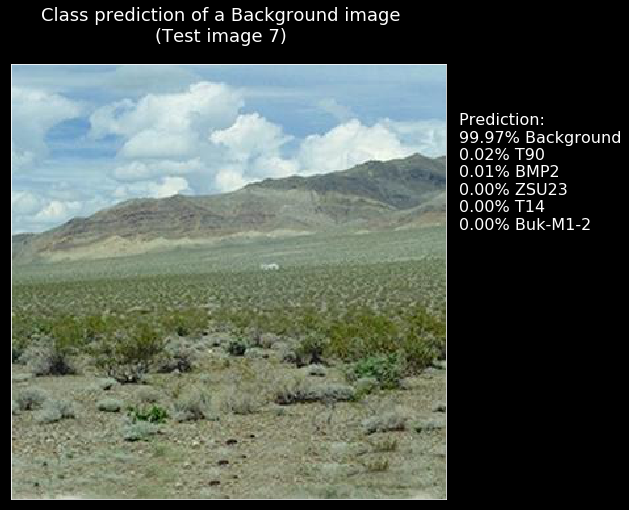

Image 8 : [(99.33, 'Background'), (0.53, 'T90'), (0.07, 'T14'), (0.04, 'BMP2'), (0.02, 'ZSU23'), (0.01, 'Buk-M1-2')]


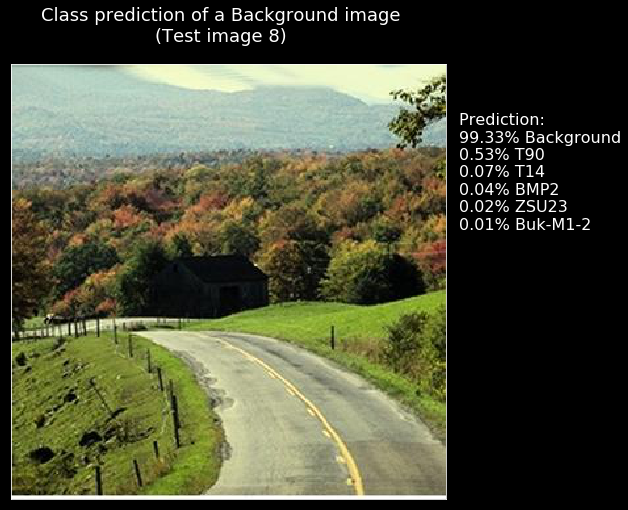

Image 9 : [(99.88, 'Background'), (0.05, 'T90'), (0.03, 'T14'), (0.02, 'Buk-M1-2'), (0.02, 'BMP2'), (0.01, 'ZSU23')]


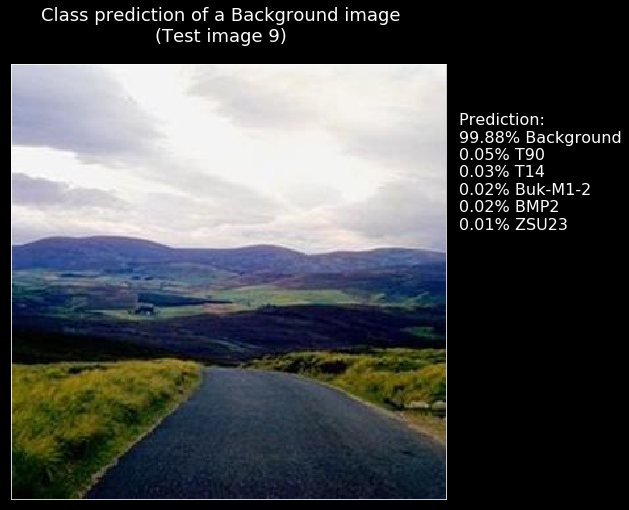

Image 10 : [(99.68, 'Background'), (0.13, 'T90'), (0.11, 'BMP2'), (0.06, 'T14'), (0.02, 'Buk-M1-2'), (0.01, 'ZSU23')]


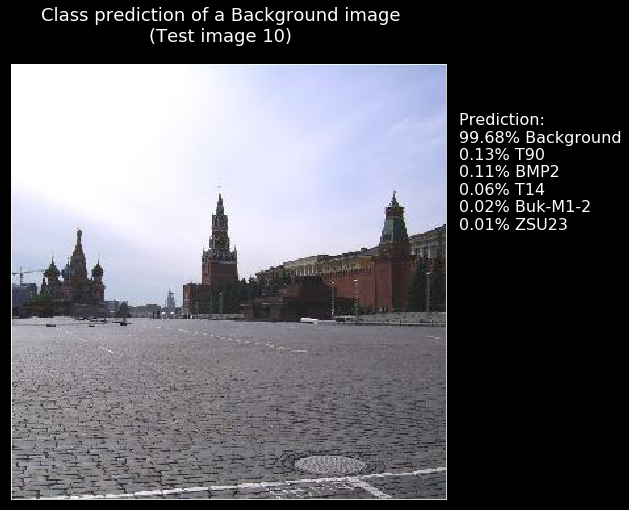

Image 11 : [(99.9, 'Background'), (0.05, 'T90'), (0.02, 'BMP2'), (0.01, 'ZSU23'), (0.01, 'T14'), (0.01, 'Buk-M1-2')]


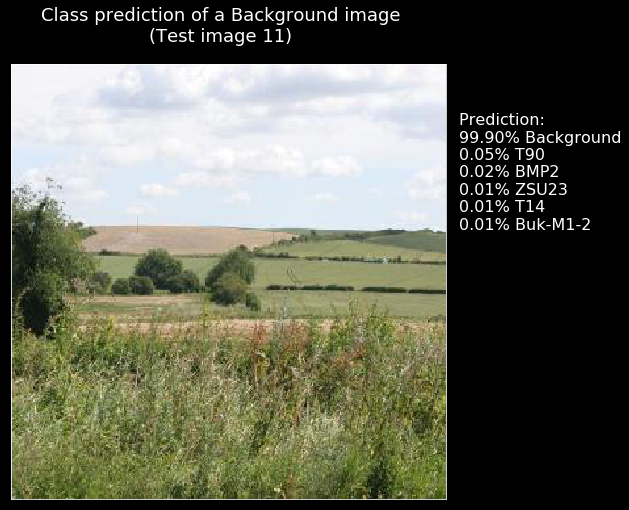

Image 12 : [(99.65, 'Background'), (0.3, 'T90'), (0.02, 'ZSU23'), (0.02, 'T14'), (0.02, 'Buk-M1-2'), (0.0, 'BMP2')]


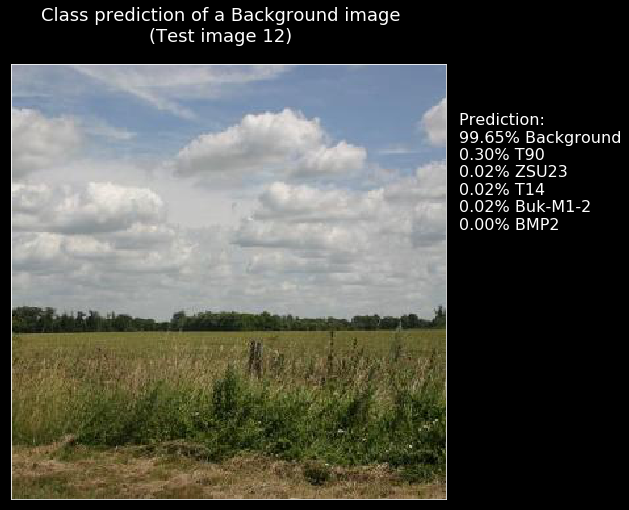

Image 13 : [(99.7, 'Background'), (0.27, 'T90'), (0.01, 'ZSU23'), (0.01, 'T14'), (0.01, 'Buk-M1-2'), (0.0, 'BMP2')]


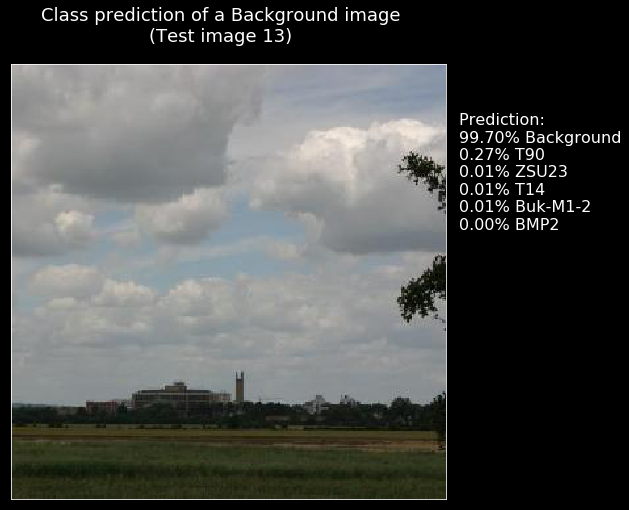

Image 14 : [(99.91, 'Background'), (0.04, 'Buk-M1-2'), (0.03, 'BMP2'), (0.02, 'T90'), (0.0, 'ZSU23'), (0.0, 'T14')]


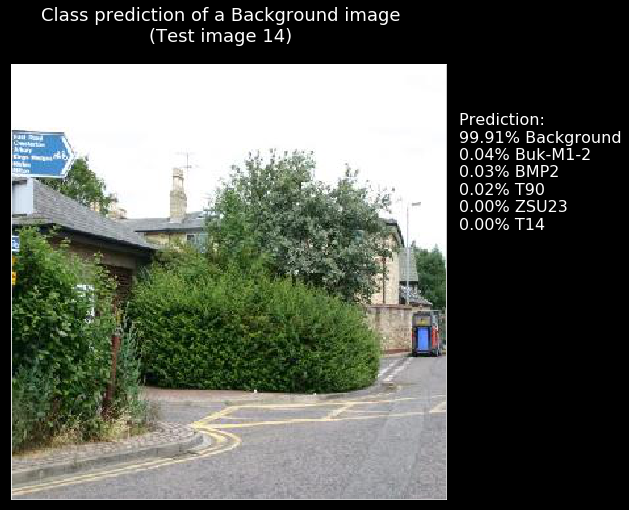

Image 15 : [(98.87, 'Background'), (0.5, 'T90'), (0.29, 'BMP2'), (0.15, 'T14'), (0.14, 'Buk-M1-2'), (0.05, 'ZSU23')]


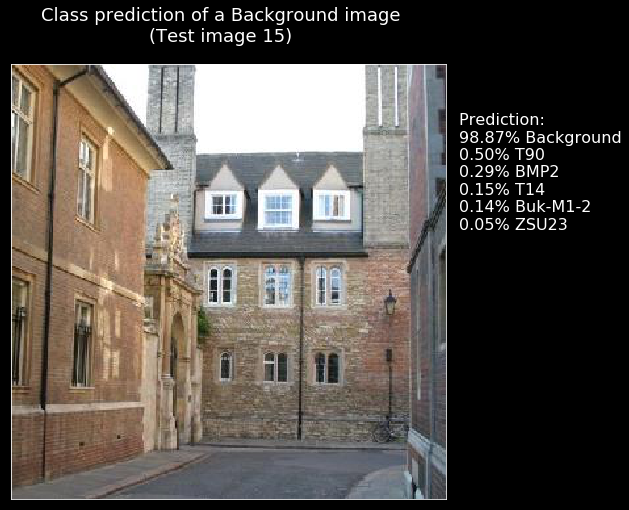

Image 16 : [(90.63, 'BMP2'), (4.75, 'ZSU23'), (2.82, 'T14'), (0.83, 'Background'), (0.65, 'T90'), (0.3, 'Buk-M1-2')]


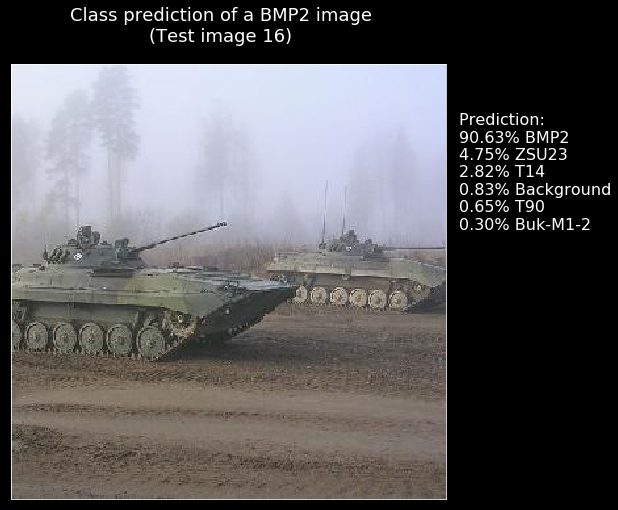

Image 17 : [(99.42, 'BMP2'), (0.24, 'Background'), (0.13, 'T14'), (0.09, 'ZSU23'), (0.07, 'Buk-M1-2'), (0.05, 'T90')]


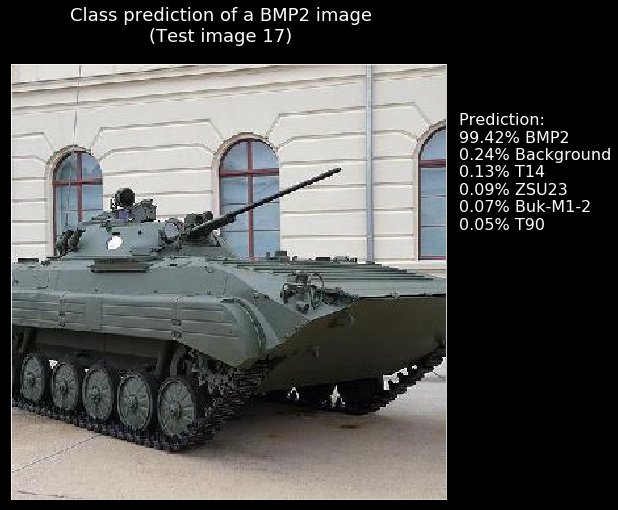

Image 18 : [(49.64, 'Buk-M1-2'), (23.07, 'ZSU23'), (12.93, 'T90'), (8.12, 'BMP2'), (5.94, 'Background'), (0.29, 'T14')]


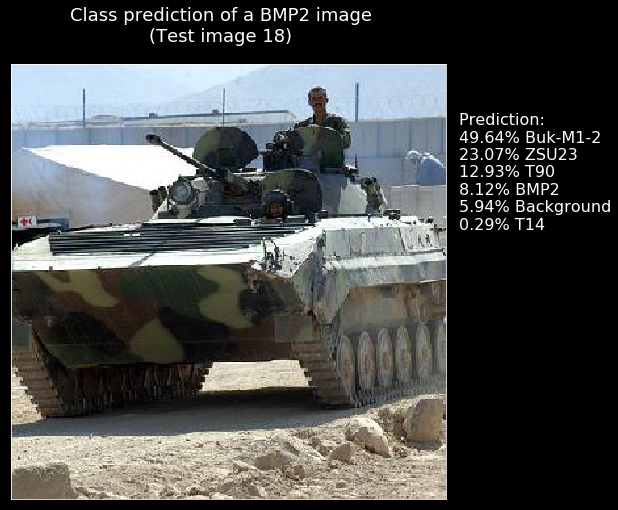

Image 19 : [(78.44, 'BMP2'), (7.65, 'Background'), (5.58, 'ZSU23'), (4.01, 'T14'), (3.37, 'T90'), (0.94, 'Buk-M1-2')]


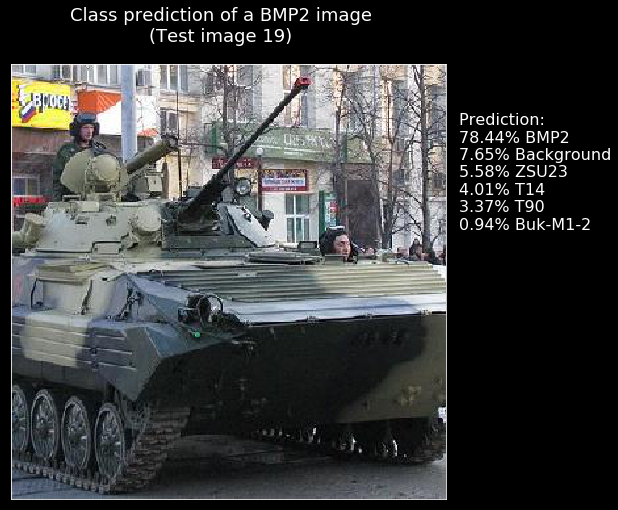

Image 20 : [(97.96, 'BMP2'), (1.02, 'Background'), (0.42, 'T90'), (0.24, 'ZSU23'), (0.23, 'T14'), (0.13, 'Buk-M1-2')]


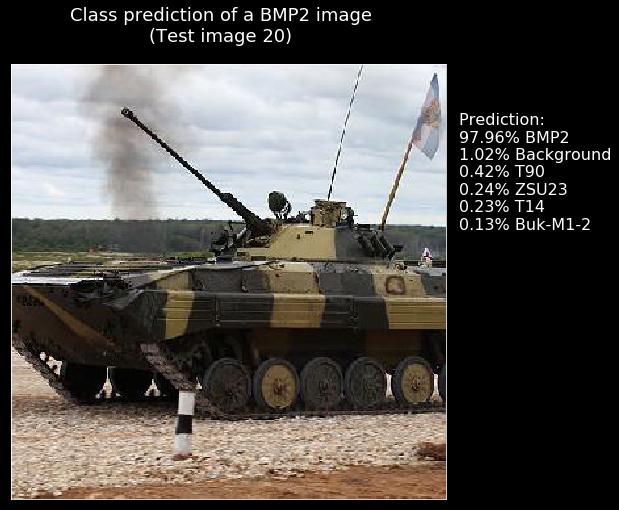

Image 21 : [(82.65, 'BMP2'), (14.49, 'Buk-M1-2'), (1.87, 'Background'), (0.53, 'T14'), (0.39, 'ZSU23'), (0.06, 'T90')]


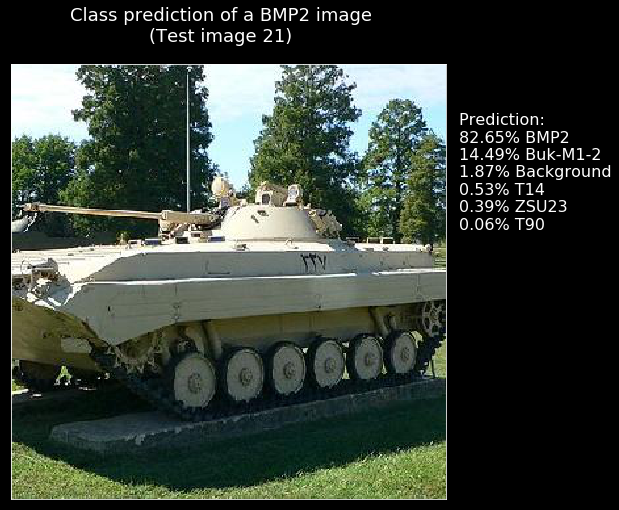

Image 22 : [(98.31, 'BMP2'), (0.69, 'ZSU23'), (0.42, 'Background'), (0.25, 'Buk-M1-2'), (0.21, 'T14'), (0.13, 'T90')]


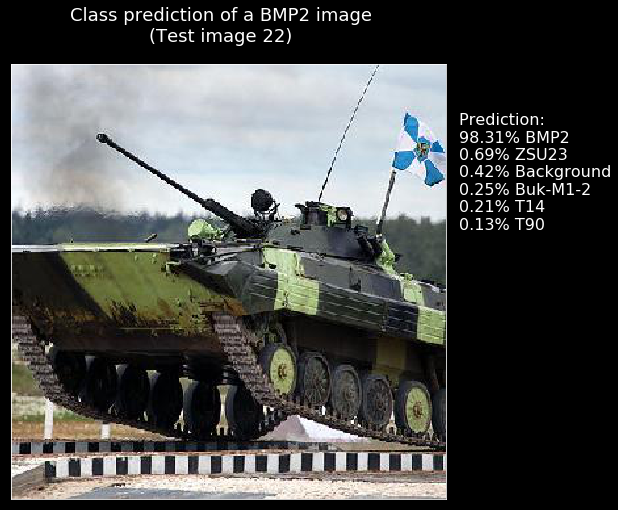

Image 23 : [(98.52, 'BMP2'), (0.64, 'Background'), (0.38, 'T90'), (0.23, 'ZSU23'), (0.18, 'Buk-M1-2'), (0.06, 'T14')]


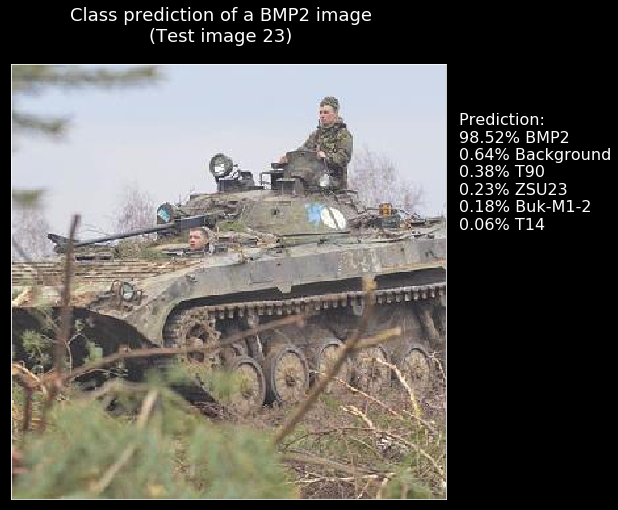

Image 24 : [(93.07, 'BMP2'), (4.41, 'T14'), (1.46, 'ZSU23'), (0.51, 'Background'), (0.39, 'Buk-M1-2'), (0.17, 'T90')]


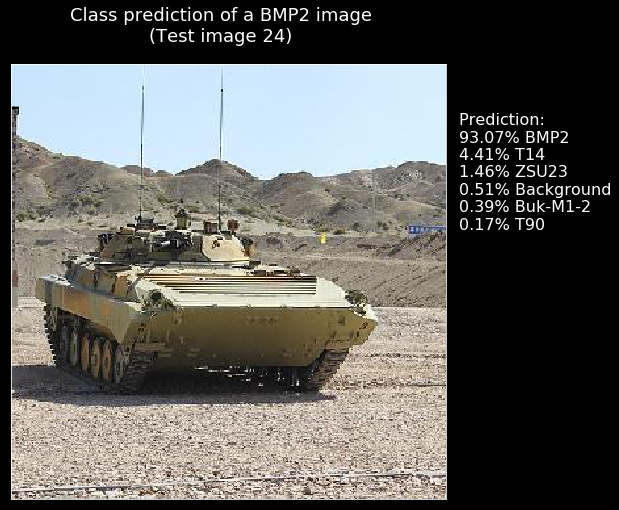

Image 25 : [(99.42, 'BMP2'), (0.18, 'T14'), (0.17, 'ZSU23'), (0.11, 'Background'), (0.07, 'Buk-M1-2'), (0.05, 'T90')]


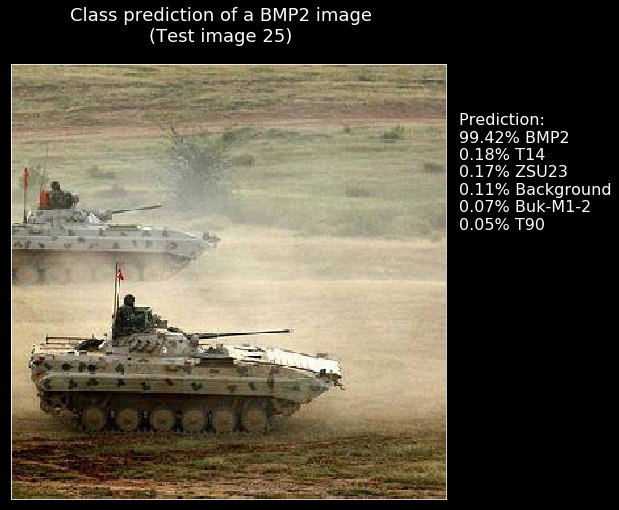

Image 26 : [(68.34, 'BMP2'), (14.37, 'T90'), (11.78, 'ZSU23'), (3.66, 'Background'), (1.18, 'Buk-M1-2'), (0.67, 'T14')]


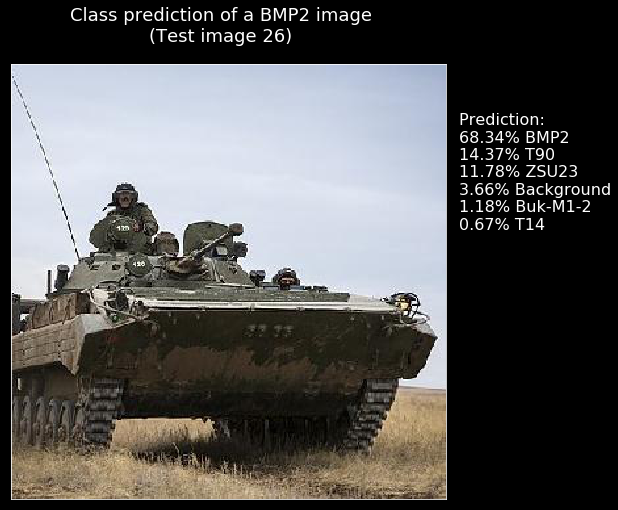

Image 27 : [(63.46, 'T14'), (13.94, 'BMP2'), (9.82, 'Background'), (6.85, 'T90'), (4.83, 'Buk-M1-2'), (1.11, 'ZSU23')]


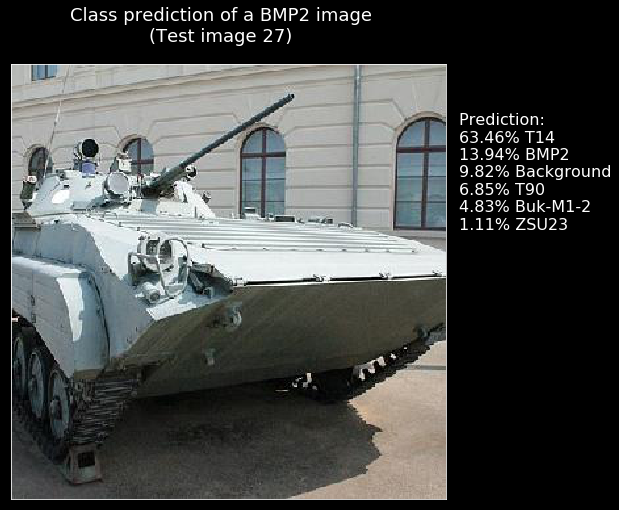

Image 28 : [(84.38, 'BMP2'), (9.27, 'ZSU23'), (3.35, 'T90'), (1.58, 'Background'), (1.32, 'T14'), (0.09, 'Buk-M1-2')]


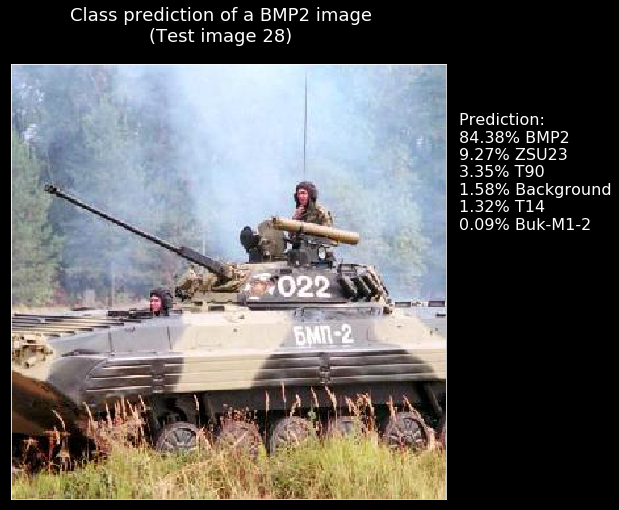

Image 29 : [(74.38, 'Background'), (20.21, 'BMP2'), (2.52, 'T14'), (1.43, 'ZSU23'), (1.23, 'T90'), (0.23, 'Buk-M1-2')]


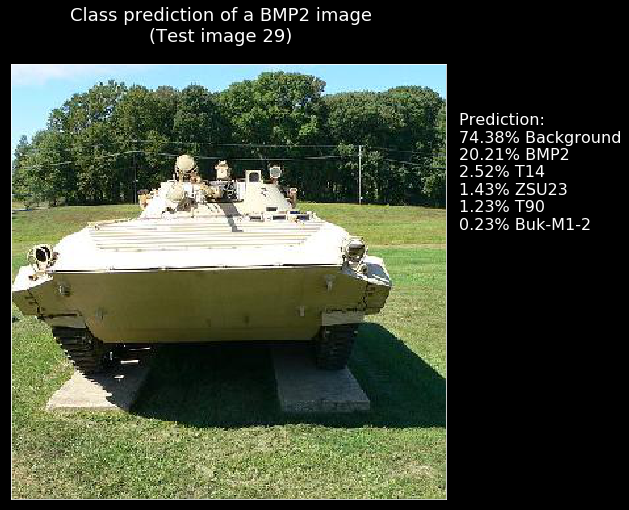

Image 30 : [(96.08, 'BMP2'), (3.45, 'T14'), (0.34, 'Buk-M1-2'), (0.08, 'ZSU23'), (0.04, 'Background'), (0.0, 'T90')]


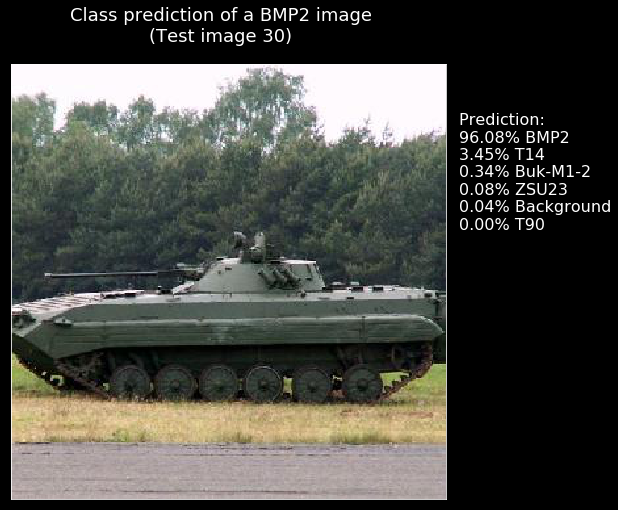

Image 31 : [(99.98, 'Buk-M1-2'), (0.01, 'BMP2'), (0.0, 'ZSU23'), (0.0, 'T90'), (0.0, 'T14'), (0.0, 'Background')]


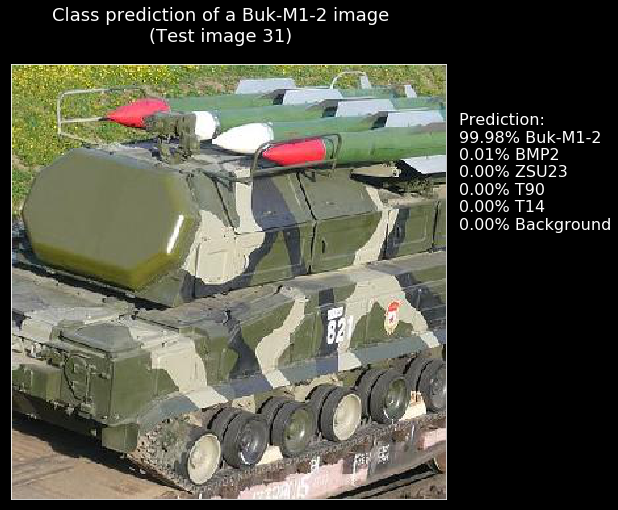

Image 32 : [(99.04, 'Buk-M1-2'), (0.57, 'BMP2'), (0.14, 'T90'), (0.14, 'Background'), (0.09, 'ZSU23'), (0.01, 'T14')]


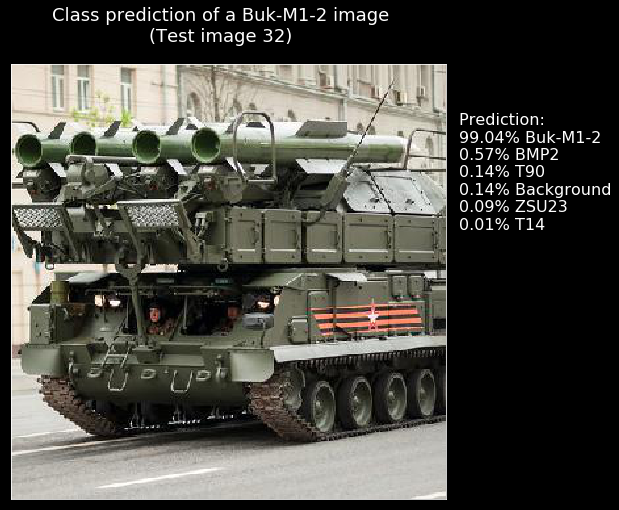

Image 33 : [(99.24, 'Buk-M1-2'), (0.4, 'BMP2'), (0.16, 'T90'), (0.15, 'Background'), (0.05, 'ZSU23'), (0.0, 'T14')]


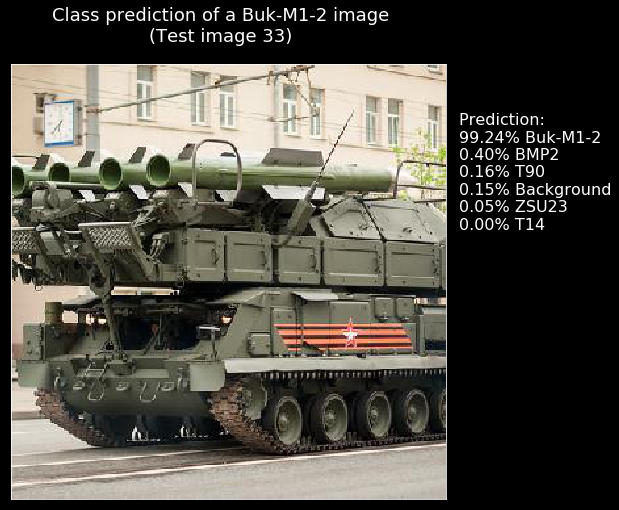

Image 34 : [(99.59, 'Buk-M1-2'), (0.22, 'ZSU23'), (0.1, 'Background'), (0.05, 'BMP2'), (0.03, 'T90'), (0.0, 'T14')]


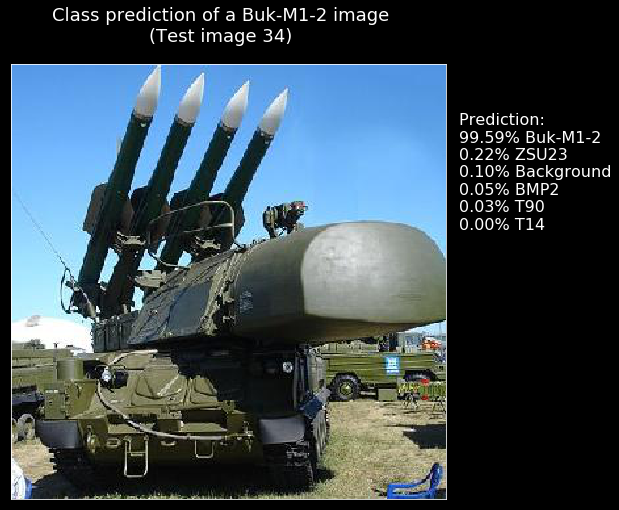

Image 35 : [(76.98, 'Buk-M1-2'), (20.07, 'Background'), (1.36, 'T90'), (0.68, 'BMP2'), (0.6, 'T14'), (0.3, 'ZSU23')]


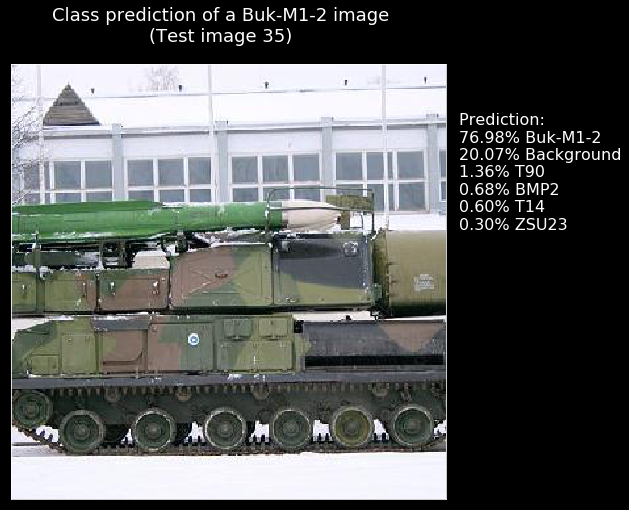

Image 36 : [(92.41, 'Buk-M1-2'), (2.89, 'T90'), (2.4, 'Background'), (1.67, 'ZSU23'), (0.58, 'BMP2'), (0.06, 'T14')]


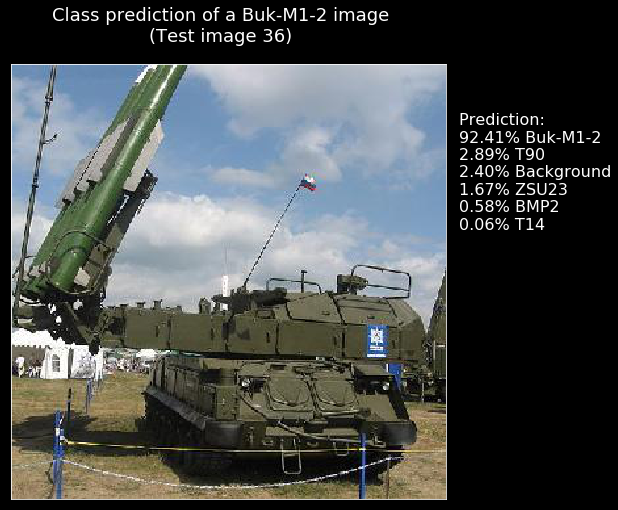

Image 37 : [(71.39, 'Buk-M1-2'), (14.32, 'BMP2'), (6.75, 'T90'), (4.01, 'ZSU23'), (3.18, 'Background'), (0.35, 'T14')]


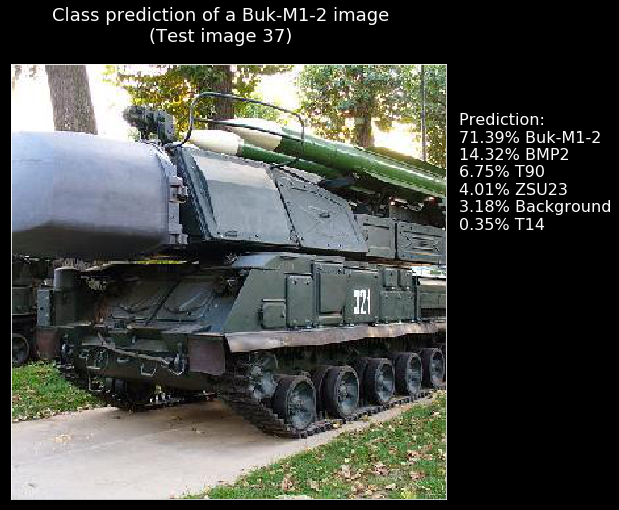

Image 38 : [(99.36, 'Buk-M1-2'), (0.29, 'ZSU23'), (0.17, 'Background'), (0.16, 'BMP2'), (0.02, 'T90'), (0.0, 'T14')]


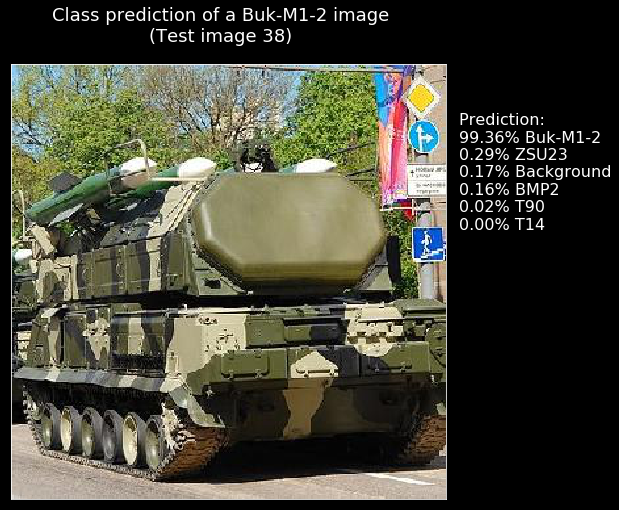

Image 39 : [(90.94, 'Buk-M1-2'), (3.75, 'T90'), (3.08, 'BMP2'), (1.4, 'Background'), (0.79, 'ZSU23'), (0.04, 'T14')]


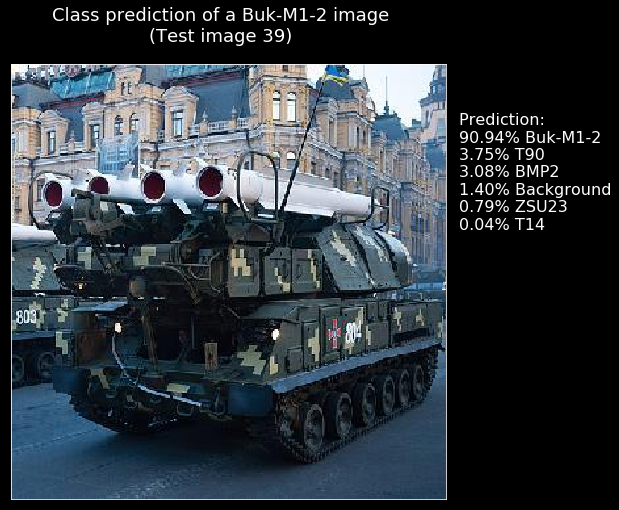

Image 40 : [(98.98, 'Buk-M1-2'), (0.67, 'Background'), (0.24, 'T90'), (0.07, 'BMP2'), (0.03, 'ZSU23'), (0.01, 'T14')]


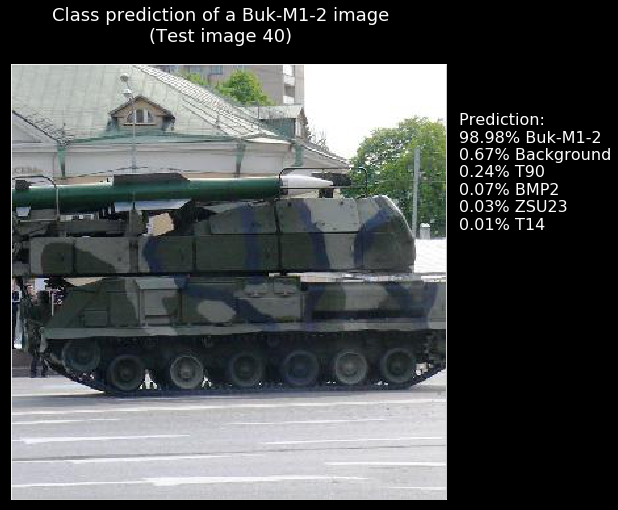

Image 41 : [(93.71, 'Buk-M1-2'), (4.25, 'BMP2'), (1.6, 'ZSU23'), (0.2, 'T90'), (0.2, 'Background'), (0.03, 'T14')]


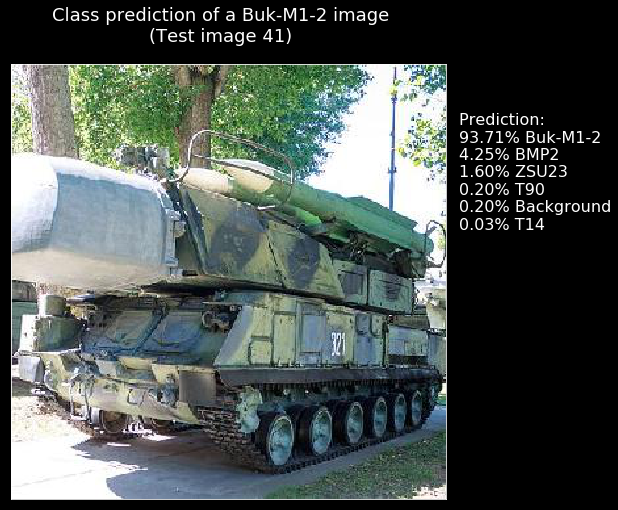

Image 42 : [(99.92, 'Buk-M1-2'), (0.07, 'BMP2'), (0.01, 'Background'), (0.0, 'ZSU23'), (0.0, 'T90'), (0.0, 'T14')]


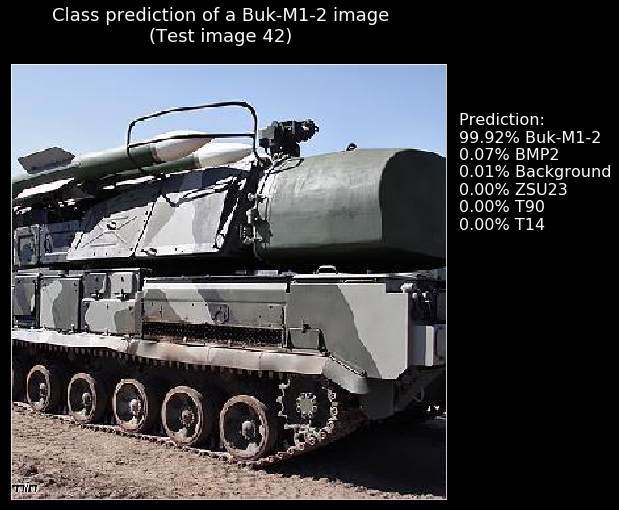

Image 43 : [(91.51, 'Buk-M1-2'), (6.7, 'BMP2'), (0.64, 'T90'), (0.63, 'Background'), (0.48, 'ZSU23'), (0.03, 'T14')]


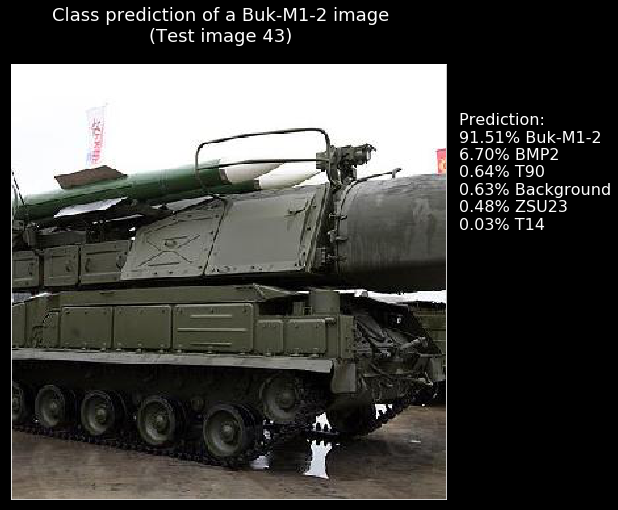

Image 44 : [(73.51, 'Buk-M1-2'), (11.1, 'BMP2'), (9.23, 'Background'), (4.28, 'T90'), (1.78, 'ZSU23'), (0.1, 'T14')]


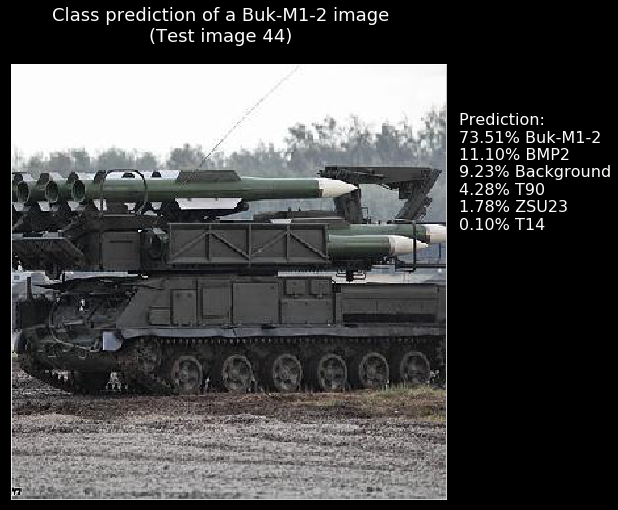

Image 45 : [(97.93, 'Buk-M1-2'), (1.2, 'Background'), (0.58, 'BMP2'), (0.15, 'T90'), (0.12, 'ZSU23'), (0.03, 'T14')]


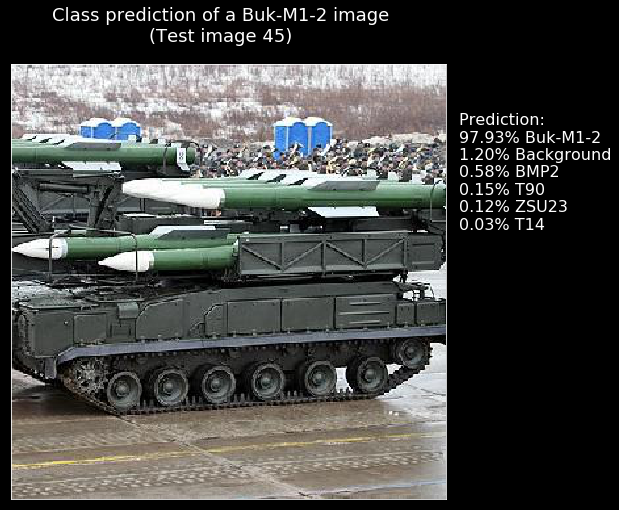

Image 46 : [(99.4, 'BMP2'), (0.31, 'T14'), (0.19, 'Background'), (0.06, 'Buk-M1-2'), (0.02, 'ZSU23'), (0.02, 'T90')]


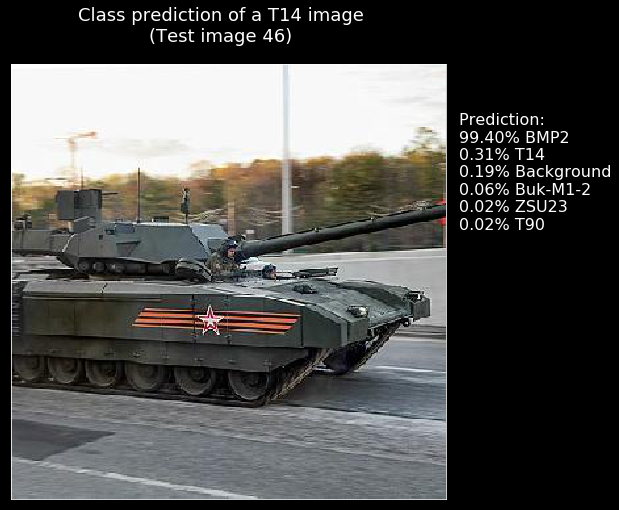

Image 47 : [(60.77, 'BMP2'), (25.24, 'T14'), (6.4, 'Buk-M1-2'), (4.47, 'Background'), (2.39, 'ZSU23'), (0.73, 'T90')]


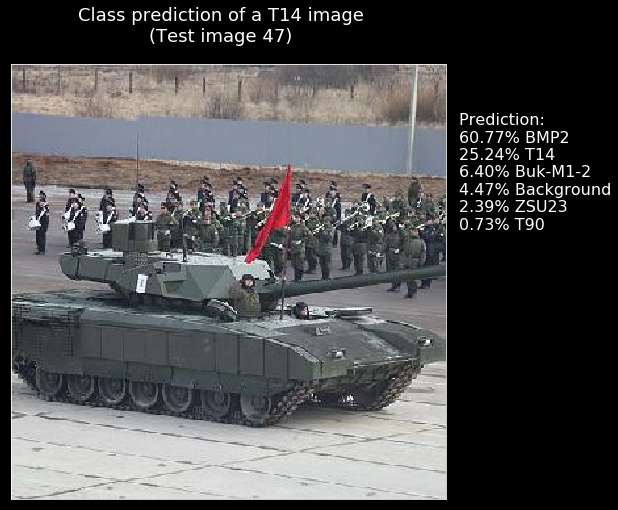

Image 48 : [(62.36, 'Buk-M1-2'), (31.41, 'BMP2'), (2.48, 'Background'), (2.35, 'T90'), (0.71, 'ZSU23'), (0.69, 'T14')]


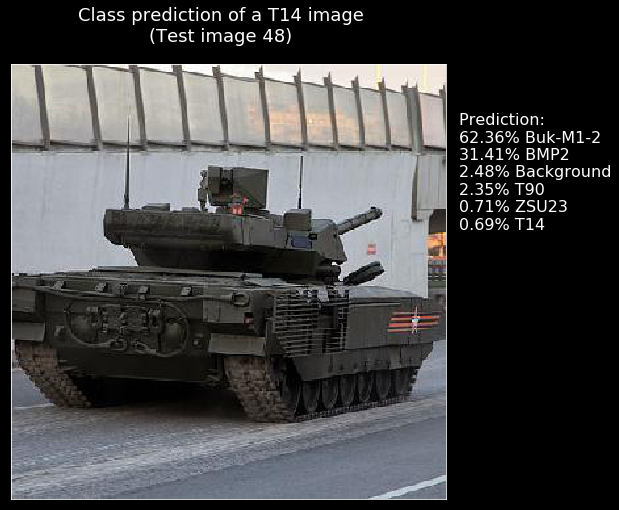

Image 49 : [(70.33, 'T14'), (26.21, 'BMP2'), (1.67, 'Buk-M1-2'), (0.68, 'Background'), (0.62, 'T90'), (0.5, 'ZSU23')]


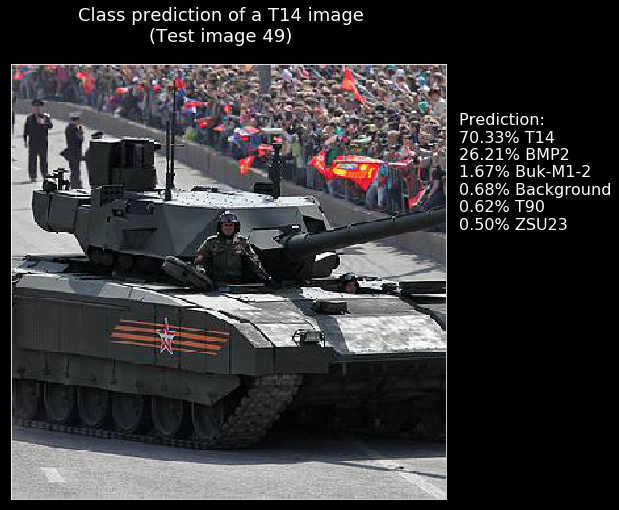

Image 50 : [(65.05, 'Buk-M1-2'), (15.72, 'Background'), (11.49, 'T14'), (5.46, 'ZSU23'), (1.78, 'BMP2'), (0.5, 'T90')]


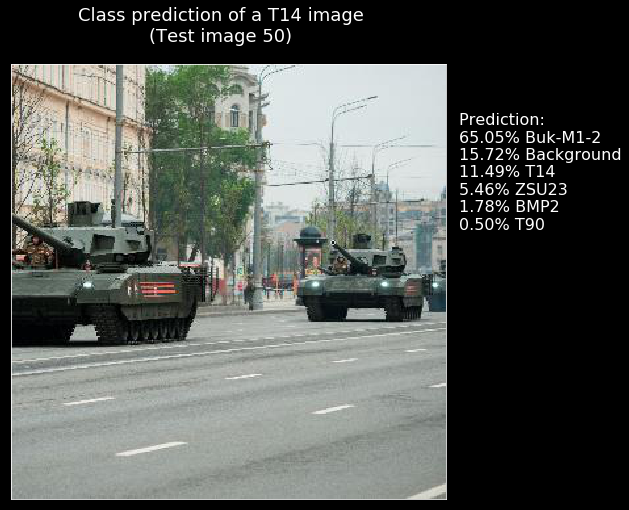

Image 51 : [(54.16, 'T14'), (42.81, 'BMP2'), (2.51, 'Buk-M1-2'), (0.38, 'Background'), (0.09, 'ZSU23'), (0.05, 'T90')]


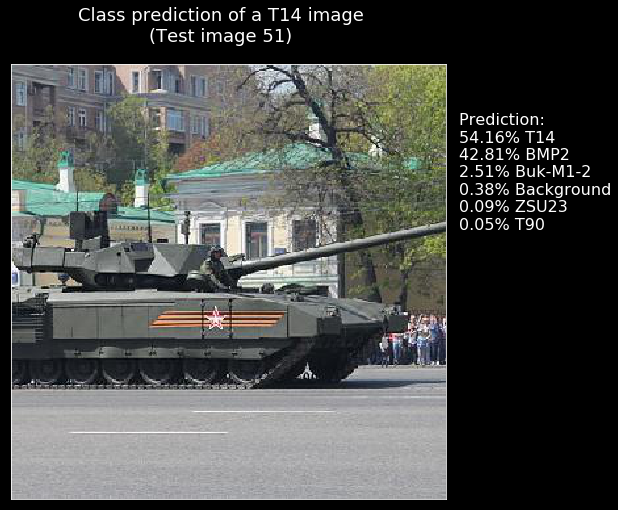

Image 52 : [(88.41, 'T14'), (3.81, 'BMP2'), (3.6, 'Buk-M1-2'), (2.77, 'T90'), (0.99, 'Background'), (0.42, 'ZSU23')]


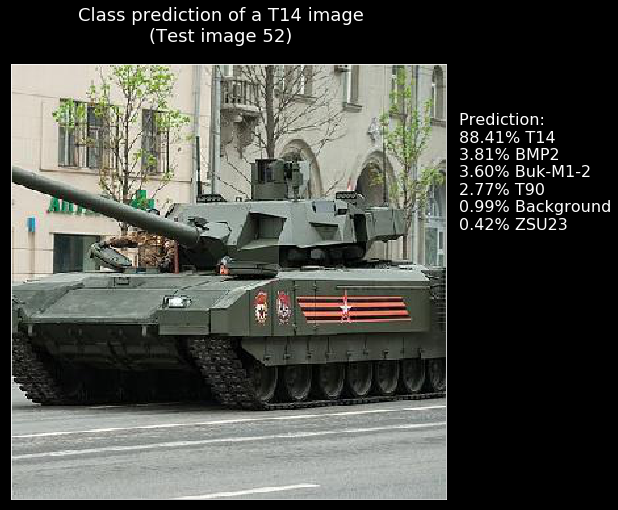

Image 53 : [(48.23, 'BMP2'), (34.14, 'Buk-M1-2'), (16.46, 'T14'), (0.61, 'Background'), (0.39, 'ZSU23'), (0.17, 'T90')]


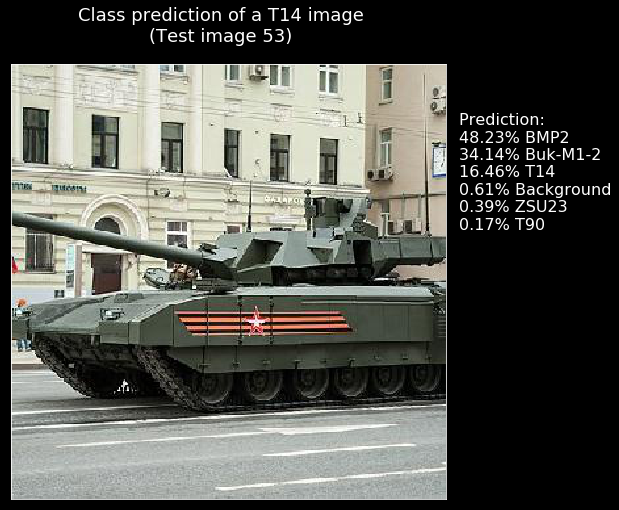

Image 54 : [(69.26, 'BMP2'), (30.08, 'T14'), (0.61, 'Buk-M1-2'), (0.04, 'ZSU23'), (0.01, 'Background'), (0.0, 'T90')]


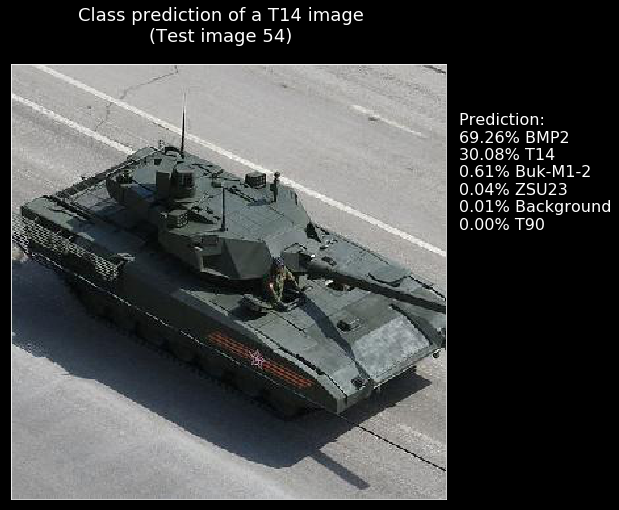

Image 55 : [(92.08, 'ZSU23'), (6.24, 'T90'), (1.13, 'Background'), (0.39, 'Buk-M1-2'), (0.11, 'BMP2'), (0.05, 'T14')]


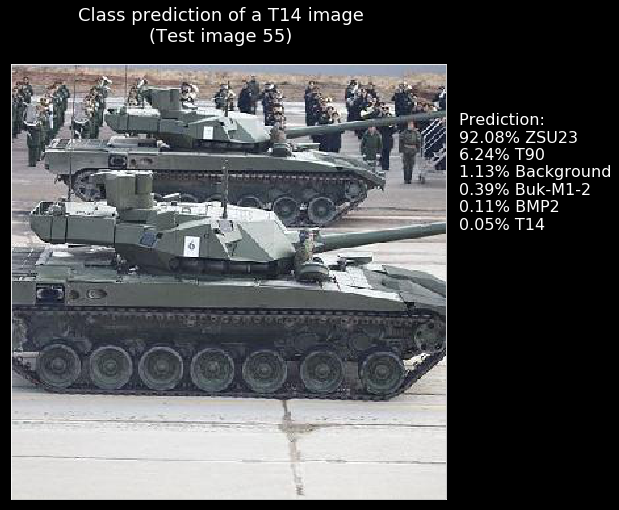

Image 56 : [(75.62, 'ZSU23'), (10.09, 'BMP2'), (8.23, 'Buk-M1-2'), (3.99, 'T14'), (1.36, 'T90'), (0.7, 'Background')]


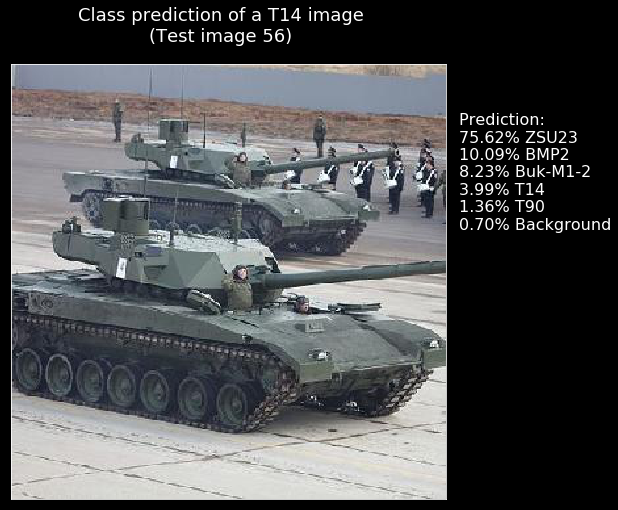

Image 57 : [(54.3, 'T14'), (37.8, 'Buk-M1-2'), (3.41, 'T90'), (2.58, 'BMP2'), (1.11, 'ZSU23'), (0.81, 'Background')]


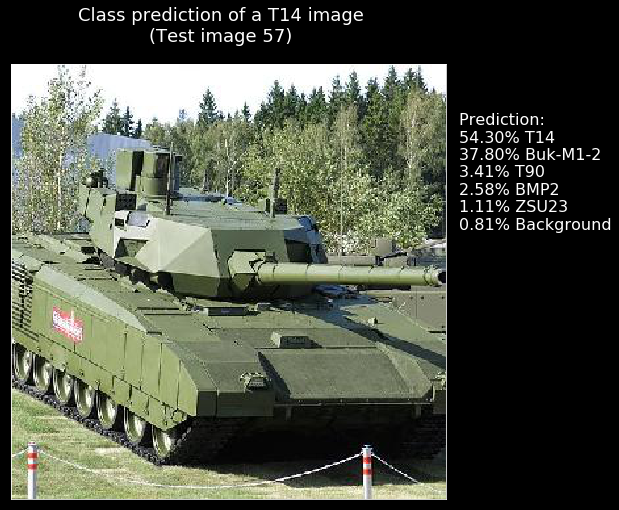

Image 58 : [(69.27, 'T14'), (10.67, 'T90'), (6.96, 'ZSU23'), (6.84, 'Background'), (4.09, 'Buk-M1-2'), (2.17, 'BMP2')]


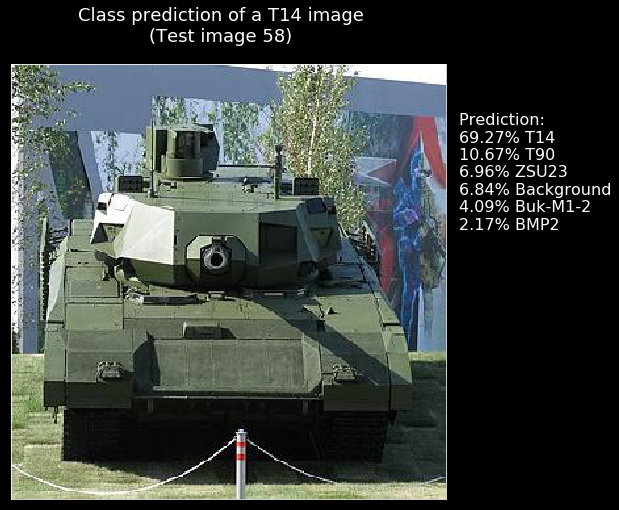

Image 59 : [(58.97, 'T14'), (30.54, 'Buk-M1-2'), (5.45, 'ZSU23'), (2.96, 'BMP2'), (1.92, 'T90'), (0.16, 'Background')]


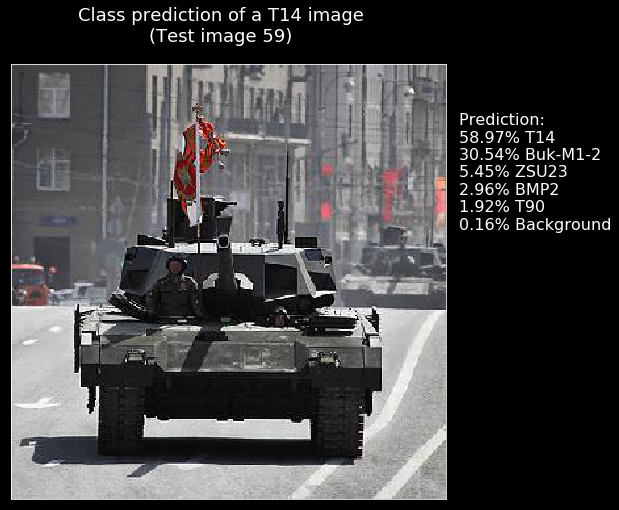

Image 60 : [(91.5, 'T14'), (4.19, 'BMP2'), (2.27, 'T90'), (1.05, 'Buk-M1-2'), (0.76, 'Background'), (0.23, 'ZSU23')]


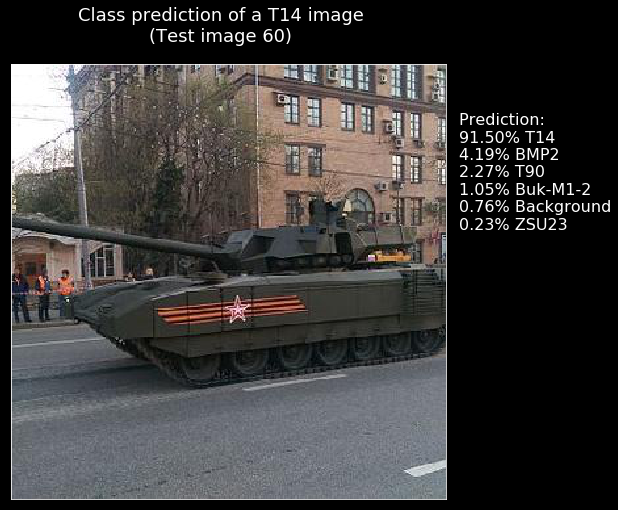

Image 61 : [(86.37, 'T90'), (10.46, 'T14'), (1.5, 'ZSU23'), (0.86, 'Background'), (0.44, 'BMP2'), (0.38, 'Buk-M1-2')]


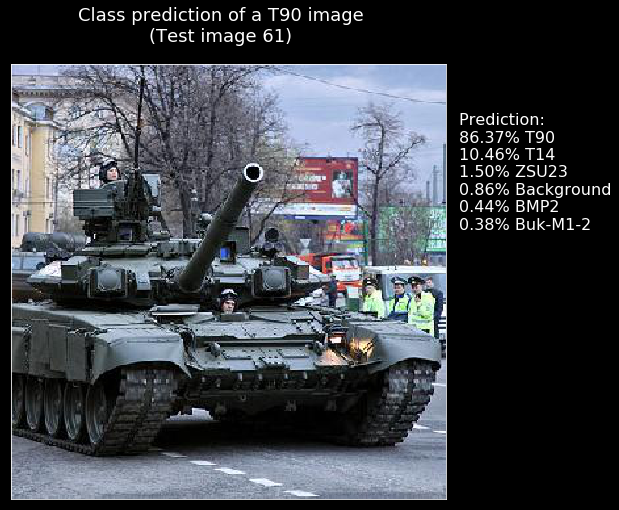

Image 62 : [(96.98, 'T90'), (1.6, 'ZSU23'), (0.89, 'T14'), (0.39, 'Background'), (0.09, 'BMP2'), (0.04, 'Buk-M1-2')]


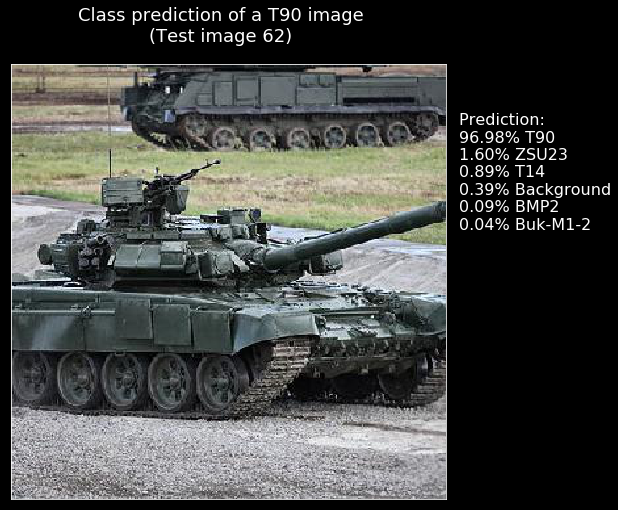

Image 63 : [(82.12, 'T90'), (10.91, 'T14'), (2.42, 'Background'), (2.35, 'BMP2'), (1.42, 'ZSU23'), (0.78, 'Buk-M1-2')]


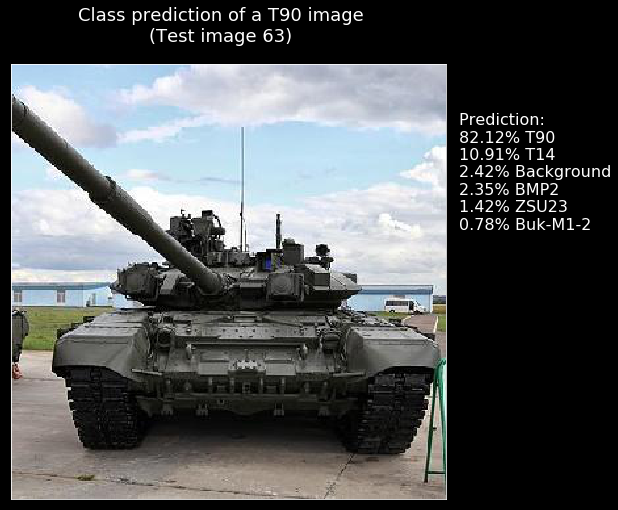

Image 64 : [(98.86, 'T90'), (0.66, 'T14'), (0.24, 'Background'), (0.21, 'ZSU23'), (0.02, 'BMP2'), (0.01, 'Buk-M1-2')]


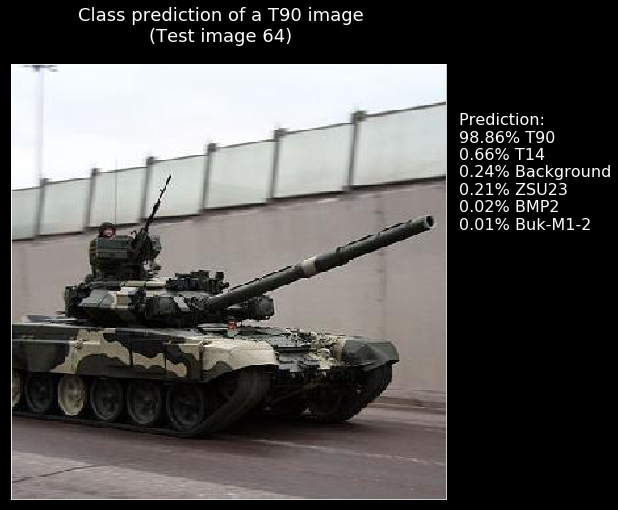

Image 65 : [(83.37, 'T90'), (15.05, 'ZSU23'), (0.78, 'T14'), (0.54, 'Background'), (0.18, 'Buk-M1-2'), (0.08, 'BMP2')]


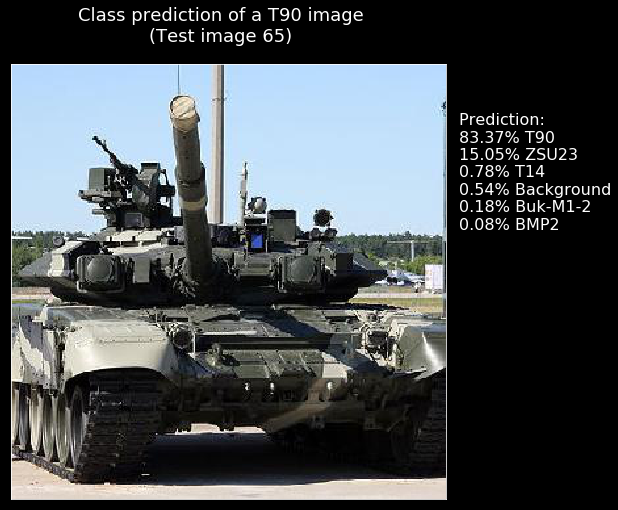

Image 66 : [(95.78, 'T90'), (2.61, 'T14'), (1.16, 'ZSU23'), (0.28, 'Background'), (0.09, 'Buk-M1-2'), (0.07, 'BMP2')]


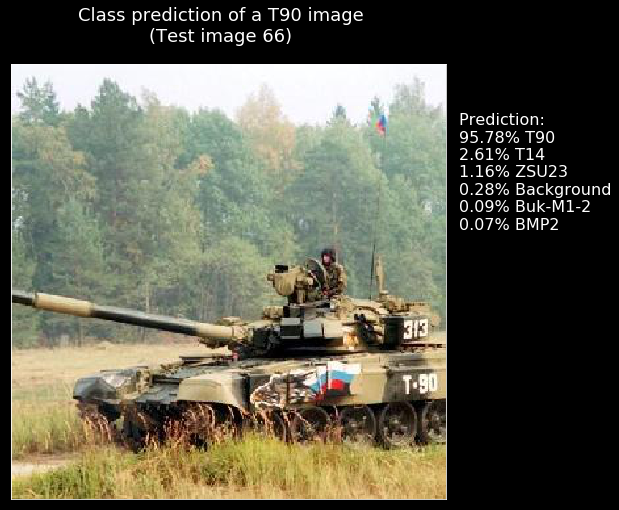

Image 67 : [(95.65, 'T90'), (1.61, 'Background'), (1.34, 'T14'), (0.96, 'ZSU23'), (0.33, 'Buk-M1-2'), (0.12, 'BMP2')]


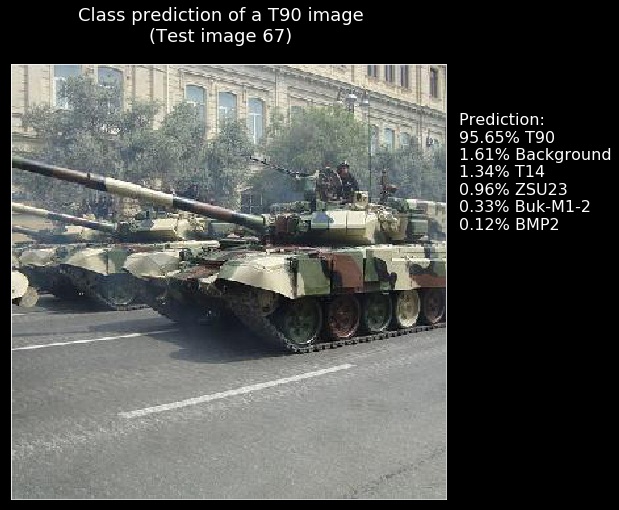

Image 68 : [(98.22, 'T90'), (0.86, 'ZSU23'), (0.69, 'T14'), (0.19, 'Background'), (0.02, 'BMP2'), (0.01, 'Buk-M1-2')]


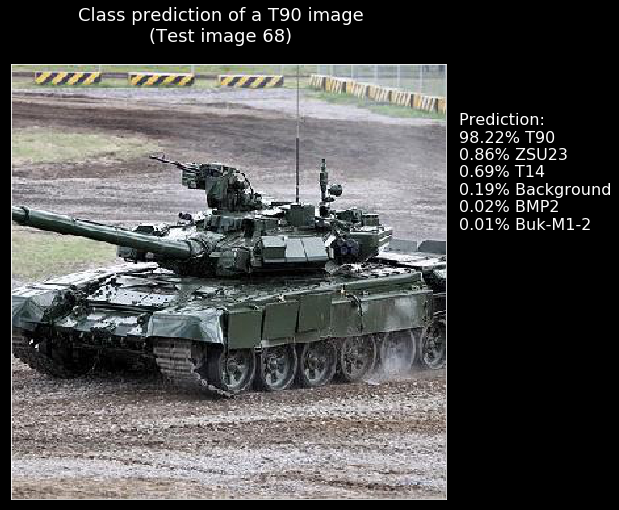

Image 69 : [(60.11, 'T14'), (17.29, 'ZSU23'), (12.81, 'Buk-M1-2'), (4.7, 'T90'), (4.62, 'Background'), (0.47, 'BMP2')]


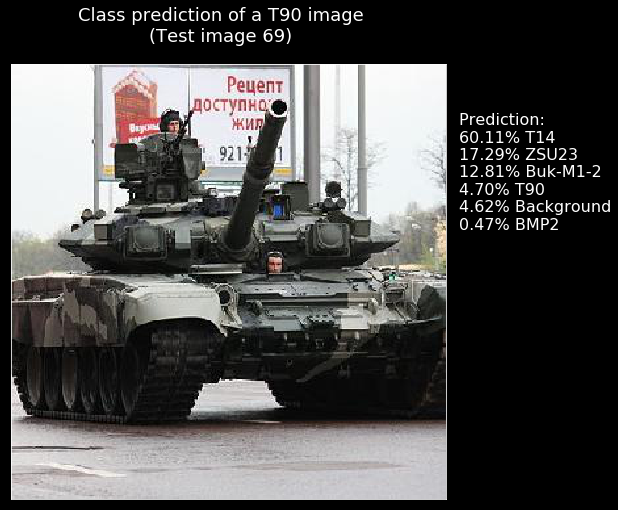

Image 70 : [(73.46, 'T90'), (13.76, 'Buk-M1-2'), (5.05, 'Background'), (3.82, 'T14'), (3.01, 'BMP2'), (0.91, 'ZSU23')]


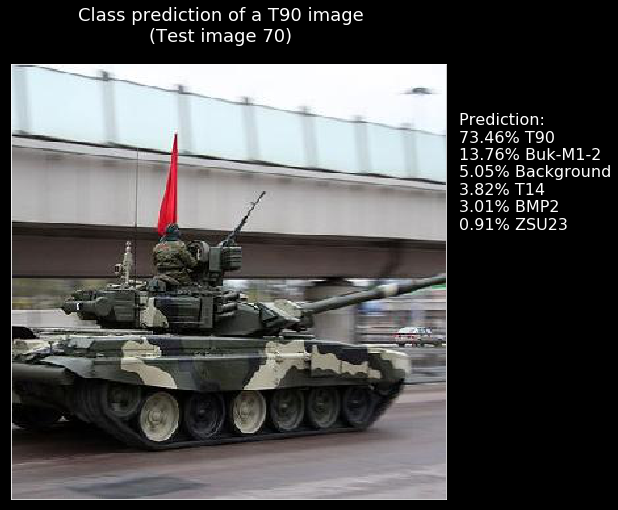

Image 71 : [(97.15, 'T90'), (1.03, 'T14'), (0.98, 'ZSU23'), (0.41, 'Background'), (0.31, 'Buk-M1-2'), (0.11, 'BMP2')]


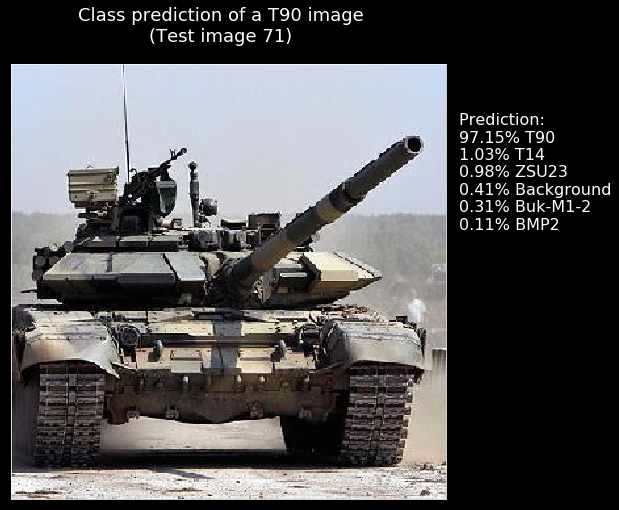

Image 72 : [(38.28, 'T90'), (26.34, 'Buk-M1-2'), (15.89, 'BMP2'), (12.69, 'ZSU23'), (5.96, 'Background'), (0.84, 'T14')]


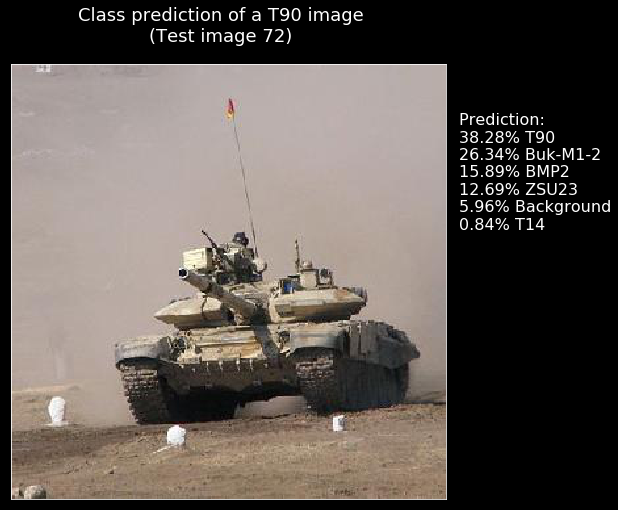

Image 73 : [(46.84, 'T90'), (45.73, 'T14'), (3.16, 'BMP2'), (1.74, 'ZSU23'), (1.34, 'Background'), (1.18, 'Buk-M1-2')]


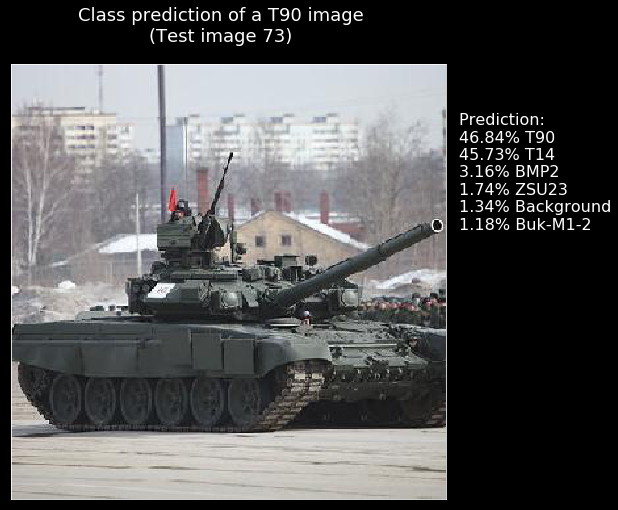

Image 74 : [(95.29, 'T90'), (2.28, 'T14'), (1.75, 'ZSU23'), (0.42, 'Background'), (0.14, 'BMP2'), (0.13, 'Buk-M1-2')]


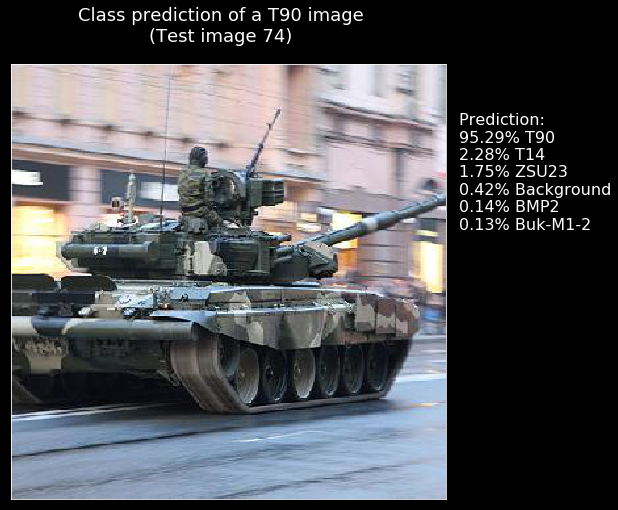

Image 75 : [(78.43, 'T90'), (17.43, 'T14'), (2.2, 'Background'), (0.93, 'ZSU23'), (0.55, 'BMP2'), (0.46, 'Buk-M1-2')]


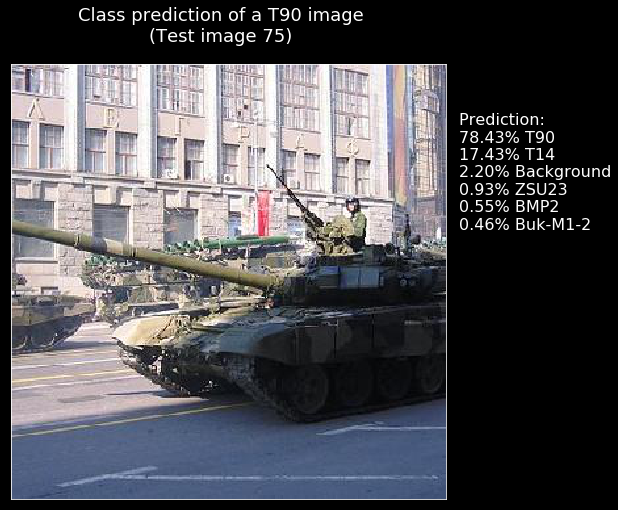

Image 76 : [(99.35, 'ZSU23'), (0.48, 'Buk-M1-2'), (0.12, 'T90'), (0.03, 'Background'), (0.02, 'BMP2'), (0.0, 'T14')]


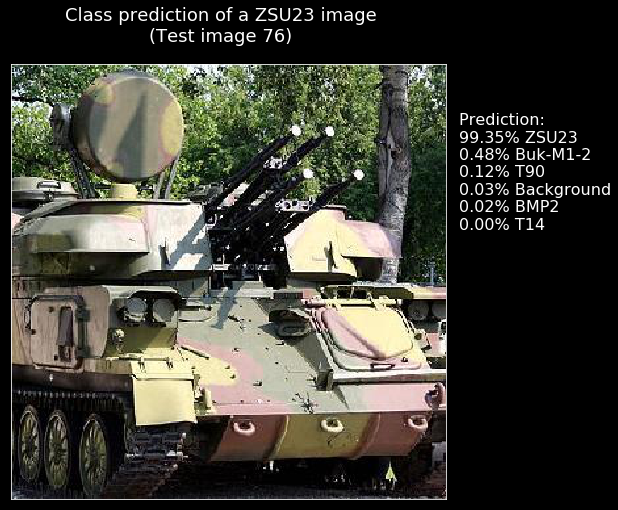

Image 77 : [(66.33, 'ZSU23'), (25.47, 'T90'), (6.23, 'Buk-M1-2'), (1.55, 'Background'), (0.34, 'BMP2'), (0.08, 'T14')]


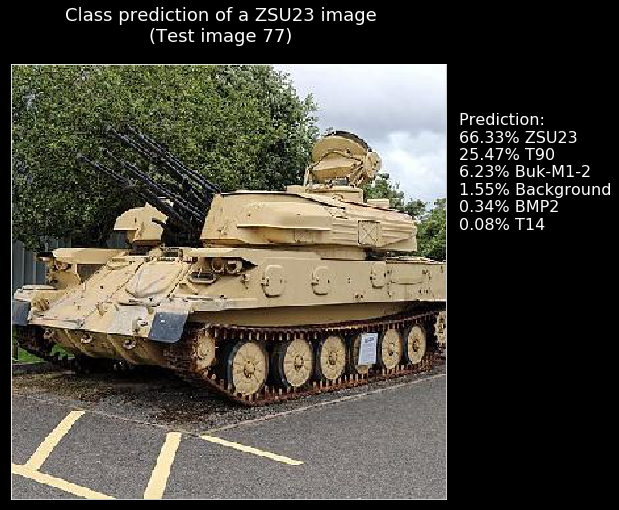

Image 78 : [(65.57, 'Buk-M1-2'), (15.55, 'ZSU23'), (14.36, 'T90'), (2.47, 'Background'), (1.93, 'BMP2'), (0.12, 'T14')]


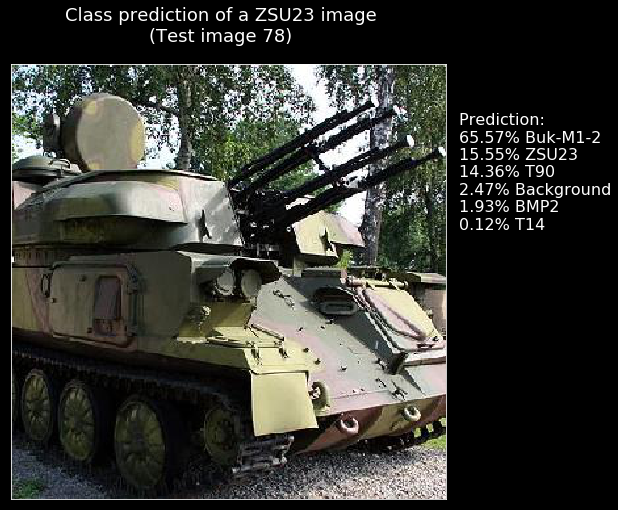

Image 79 : [(99.95, 'ZSU23'), (0.04, 'Buk-M1-2'), (0.0, 'T90'), (0.0, 'T14'), (0.0, 'Background'), (0.0, 'BMP2')]


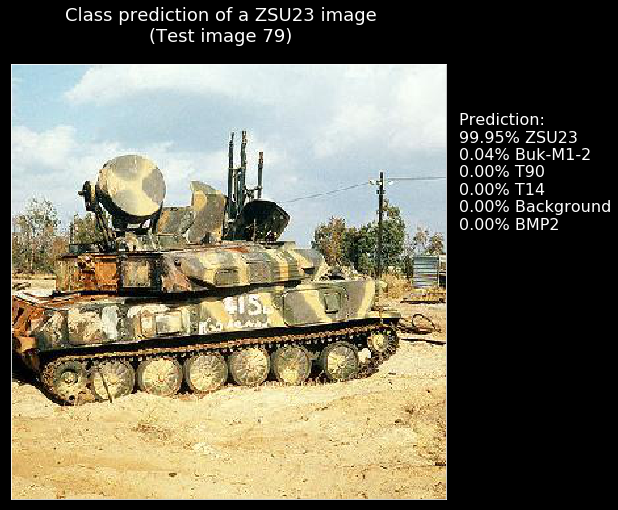

Image 80 : [(98.05, 'ZSU23'), (1.21, 'Buk-M1-2'), (0.33, 'T90'), (0.29, 'BMP2'), (0.12, 'Background'), (0.01, 'T14')]


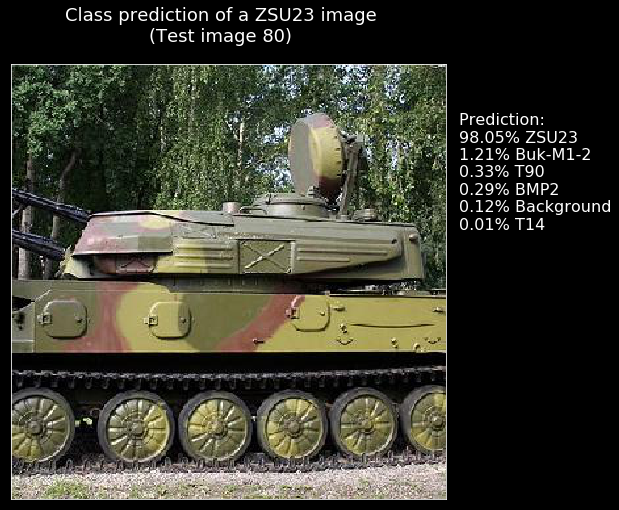

Image 81 : [(52.13, 'ZSU23'), (46.6, 'Buk-M1-2'), (0.75, 'Background'), (0.44, 'T90'), (0.08, 'BMP2'), (0.01, 'T14')]


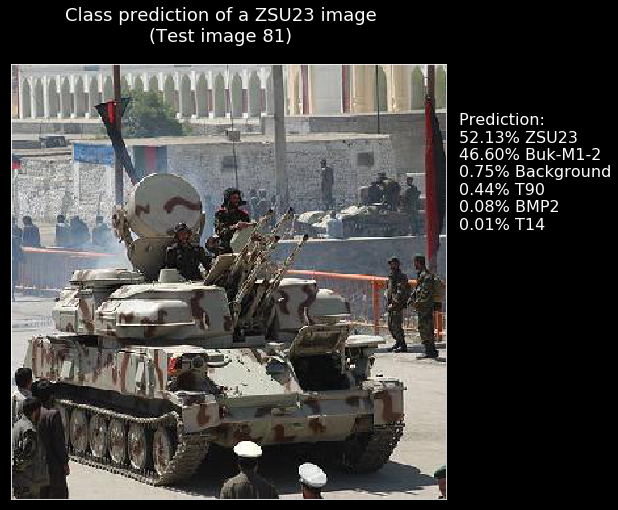

Image 82 : [(86.73, 'ZSU23'), (4.4, 'BMP2'), (3.68, 'Background'), (2.84, 'T90'), (2.14, 'Buk-M1-2'), (0.21, 'T14')]


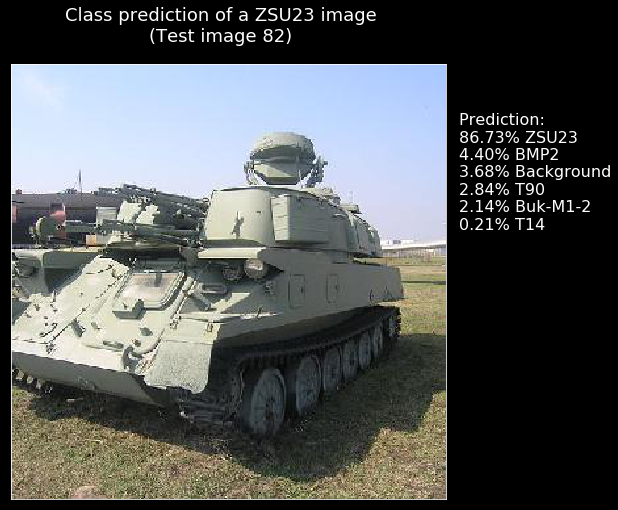

Image 83 : [(76.64, 'Buk-M1-2'), (12.07, 'ZSU23'), (7.3, 'T90'), (1.69, 'T14'), (1.48, 'BMP2'), (0.82, 'Background')]


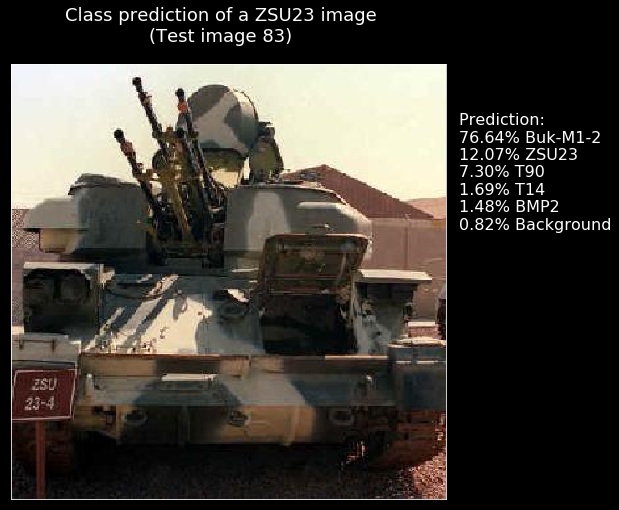

Image 84 : [(93.36, 'ZSU23'), (3.1, 'Buk-M1-2'), (1.63, 'Background'), (0.79, 'BMP2'), (0.61, 'T90'), (0.51, 'T14')]


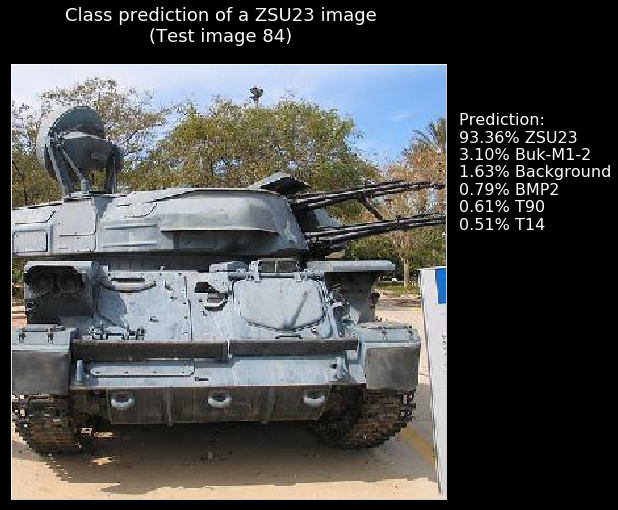

Image 85 : [(99.38, 'Buk-M1-2'), (0.29, 'ZSU23'), (0.2, 'BMP2'), (0.06, 'T90'), (0.06, 'T14'), (0.01, 'Background')]


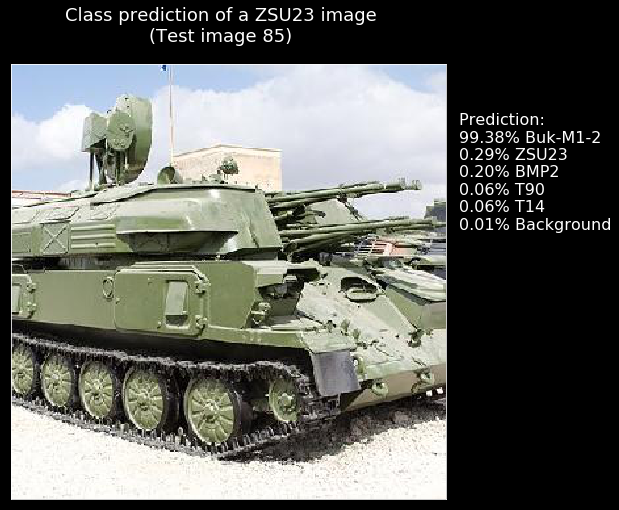

Image 86 : [(99.95, 'ZSU23'), (0.02, 'T90'), (0.02, 'Background'), (0.0, 'T14'), (0.0, 'Buk-M1-2'), (0.0, 'BMP2')]


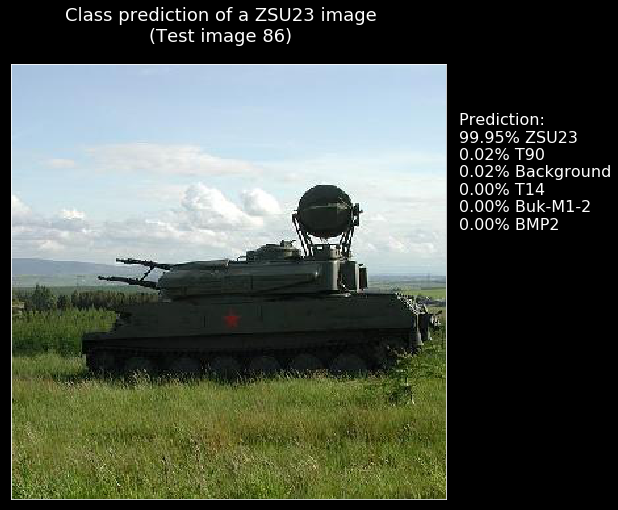

Image 87 : [(94.84, 'ZSU23'), (2.45, 'Buk-M1-2'), (1.21, 'BMP2'), (1.09, 'T90'), (0.4, 'Background'), (0.01, 'T14')]


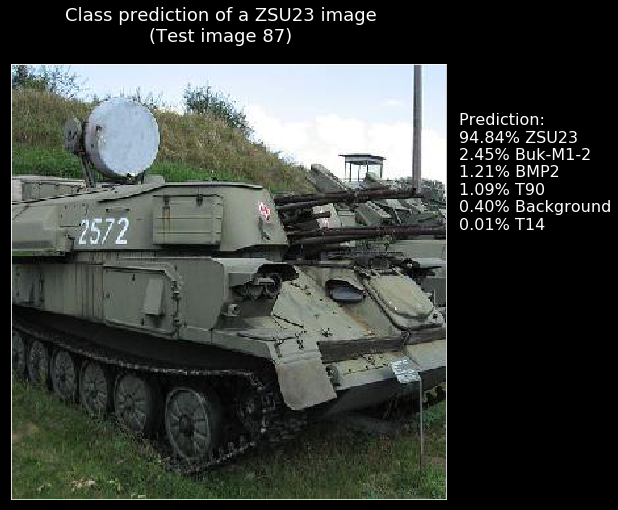

Image 88 : [(99.92, 'ZSU23'), (0.03, 'Buk-M1-2'), (0.03, 'BMP2'), (0.01, 'T90'), (0.01, 'Background'), (0.0, 'T14')]


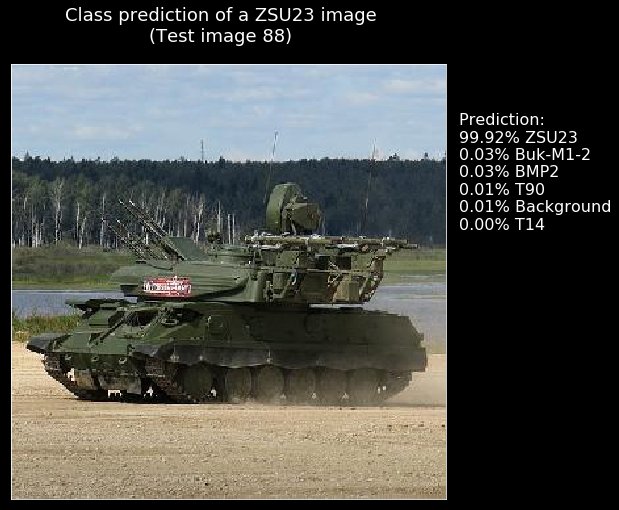

Image 89 : [(99.43, 'ZSU23'), (0.49, 'T90'), (0.03, 'Background'), (0.03, 'BMP2'), (0.01, 'T14'), (0.01, 'Buk-M1-2')]


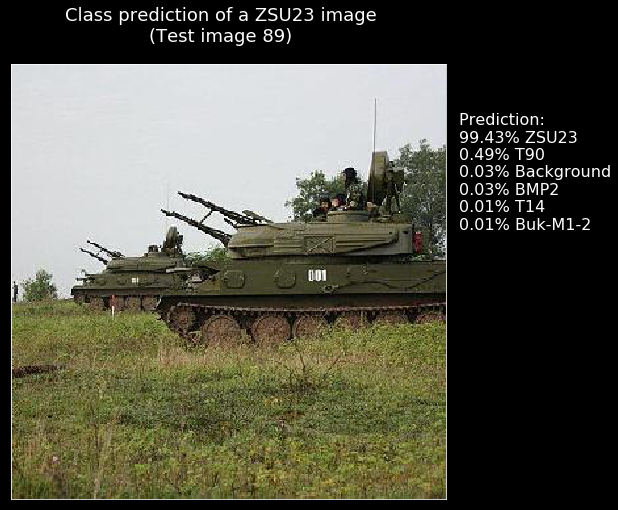

Image 90 : [(83.6, 'BMP2'), (12.06, 'ZSU23'), (3.33, 'T14'), (0.49, 'Background'), (0.44, 'Buk-M1-2'), (0.08, 'T90')]


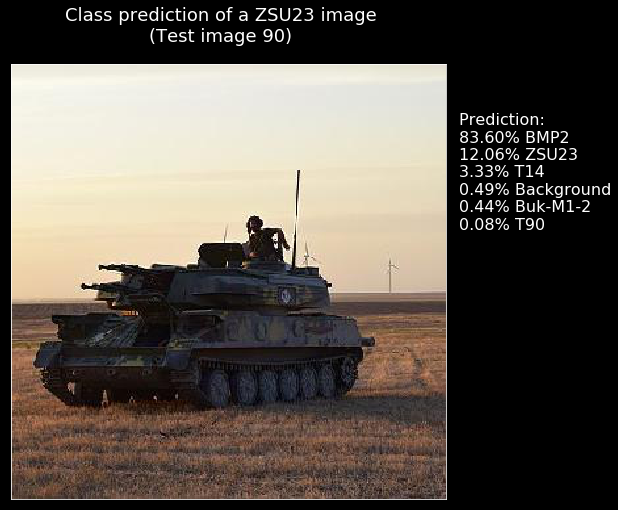

In [60]:
analysis()
plot_images()